In [97]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
import json
import mysql.connector as con

In [2]:
pip install -U dataprep

^C
Note: you may need to restart the kernel to use updated packages.


In [3]:
with open('good.json') as f:
    data = json.load(f)
data

{'audio_features': [{'danceability': 0.749,
   'energy': 0.839,
   'key': 6,
   'loudness': -4.847,
   'mode': 1,
   'speechiness': 0.297,
   'acousticness': 0.0867,
   'instrumentalness': 0,
   'liveness': 0.204,
   'valence': 0.804,
   'tempo': 172.068,
   'type': 'audio_features',
   'id': '55mcupbf7cIsuCEVAuTJVk',
   'uri': 'spotify:track:55mcupbf7cIsuCEVAuTJVk',
   'track_href': 'https://api.spotify.com/v1/tracks/55mcupbf7cIsuCEVAuTJVk',
   'analysis_url': 'https://api.spotify.com/v1/audio-analysis/55mcupbf7cIsuCEVAuTJVk',
   'duration_ms': 111000,
   'time_signature': 4},
  {'danceability': 0.573,
   'energy': 0.581,
   'key': 10,
   'loudness': -9.026,
   'mode': 0,
   'speechiness': 0.339,
   'acousticness': 0.753,
   'instrumentalness': 1.39e-06,
   'liveness': 0.13,
   'valence': 0.351,
   'tempo': 76.506,
   'type': 'audio_features',
   'id': '57RtLWT7IpugV0yi5bsxJk',
   'uri': 'spotify:track:57RtLWT7IpugV0yi5bsxJk',
   'track_href': 'https://api.spotify.com/v1/tracks/57RtLW

In [4]:
features = []
for x in data['audio_features']:
    print(x,'\n####################\n')
    for xx,yy in x.items():
        print(xx,'@',yy)
        features.append(xx)
        
    break

{'danceability': 0.749, 'energy': 0.839, 'key': 6, 'loudness': -4.847, 'mode': 1, 'speechiness': 0.297, 'acousticness': 0.0867, 'instrumentalness': 0, 'liveness': 0.204, 'valence': 0.804, 'tempo': 172.068, 'type': 'audio_features', 'id': '55mcupbf7cIsuCEVAuTJVk', 'uri': 'spotify:track:55mcupbf7cIsuCEVAuTJVk', 'track_href': 'https://api.spotify.com/v1/tracks/55mcupbf7cIsuCEVAuTJVk', 'analysis_url': 'https://api.spotify.com/v1/audio-analysis/55mcupbf7cIsuCEVAuTJVk', 'duration_ms': 111000, 'time_signature': 4} 
####################

danceability @ 0.749
energy @ 0.839
key @ 6
loudness @ -4.847
mode @ 1
speechiness @ 0.297
acousticness @ 0.0867
instrumentalness @ 0
liveness @ 0.204
valence @ 0.804
tempo @ 172.068
type @ audio_features
id @ 55mcupbf7cIsuCEVAuTJVk
uri @ spotify:track:55mcupbf7cIsuCEVAuTJVk
track_href @ https://api.spotify.com/v1/tracks/55mcupbf7cIsuCEVAuTJVk
analysis_url @ https://api.spotify.com/v1/audio-analysis/55mcupbf7cIsuCEVAuTJVk
duration_ms @ 111000
time_signature @ 

In [5]:
features

['danceability',
 'energy',
 'key',
 'loudness',
 'mode',
 'speechiness',
 'acousticness',
 'instrumentalness',
 'liveness',
 'valence',
 'tempo',
 'type',
 'id',
 'uri',
 'track_href',
 'analysis_url',
 'duration_ms',
 'time_signature']

In [6]:
features.remove('id')
features.insert(0, 'id')

In [7]:
features

['id',
 'danceability',
 'energy',
 'key',
 'loudness',
 'mode',
 'speechiness',
 'acousticness',
 'instrumentalness',
 'liveness',
 'valence',
 'tempo',
 'type',
 'uri',
 'track_href',
 'analysis_url',
 'duration_ms',
 'time_signature']

In [8]:
good_df = pd.DataFrame(columns=features)
good_df

,id,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,type,uri,track_href,analysis_url,duration_ms,time_signature


In [9]:
features = []
row_index = 0
for x in data['audio_features']:
    print(x,'\n####################\n')
    for xx,yy in x.items():
        print(xx,'@',yy)
        good_df.loc[row_index, xx] = yy
    row_index+=1

{'danceability': 0.749, 'energy': 0.839, 'key': 6, 'loudness': -4.847, 'mode': 1, 'speechiness': 0.297, 'acousticness': 0.0867, 'instrumentalness': 0, 'liveness': 0.204, 'valence': 0.804, 'tempo': 172.068, 'type': 'audio_features', 'id': '55mcupbf7cIsuCEVAuTJVk', 'uri': 'spotify:track:55mcupbf7cIsuCEVAuTJVk', 'track_href': 'https://api.spotify.com/v1/tracks/55mcupbf7cIsuCEVAuTJVk', 'analysis_url': 'https://api.spotify.com/v1/audio-analysis/55mcupbf7cIsuCEVAuTJVk', 'duration_ms': 111000, 'time_signature': 4} 
####################

danceability @ 0.749
energy @ 0.839
key @ 6
loudness @ -4.847
mode @ 1
speechiness @ 0.297
acousticness @ 0.0867
instrumentalness @ 0
liveness @ 0.204
valence @ 0.804
tempo @ 172.068
type @ audio_features
id @ 55mcupbf7cIsuCEVAuTJVk
uri @ spotify:track:55mcupbf7cIsuCEVAuTJVk
track_href @ https://api.spotify.com/v1/tracks/55mcupbf7cIsuCEVAuTJVk
analysis_url @ https://api.spotify.com/v1/audio-analysis/55mcupbf7cIsuCEVAuTJVk
duration_ms @ 111000
time_signature @ 

type @ audio_features
id @ 6u1rhQAvxkWLeuqUC3iJD0
uri @ spotify:track:6u1rhQAvxkWLeuqUC3iJD0
track_href @ https://api.spotify.com/v1/tracks/6u1rhQAvxkWLeuqUC3iJD0
analysis_url @ https://api.spotify.com/v1/audio-analysis/6u1rhQAvxkWLeuqUC3iJD0
duration_ms @ 214456
time_signature @ 4
{'danceability': 0.641, 'energy': 0.673, 'key': 6, 'loudness': -7.017, 'mode': 0, 'speechiness': 0.0857, 'acousticness': 0.429, 'instrumentalness': 0, 'liveness': 0.105, 'valence': 0.785, 'tempo': 149.974, 'type': 'audio_features', 'id': '2MCAs3ttHSuDm1RHL0rqTF', 'uri': 'spotify:track:2MCAs3ttHSuDm1RHL0rqTF', 'track_href': 'https://api.spotify.com/v1/tracks/2MCAs3ttHSuDm1RHL0rqTF', 'analysis_url': 'https://api.spotify.com/v1/audio-analysis/2MCAs3ttHSuDm1RHL0rqTF', 'duration_ms': 192107, 'time_signature': 4} 
####################

danceability @ 0.641
energy @ 0.673
key @ 6
loudness @ -7.017
mode @ 0
speechiness @ 0.0857
acousticness @ 0.429
instrumentalness @ 0
liveness @ 0.105
valence @ 0.785
tempo @ 149.97

mode @ 0
speechiness @ 0.191
acousticness @ 0.684
instrumentalness @ 0
liveness @ 0.119
valence @ 0.591
tempo @ 150.067
type @ audio_features
id @ 1NW4kNeeaRl5xxOnOLsYIJ
uri @ spotify:track:1NW4kNeeaRl5xxOnOLsYIJ
track_href @ https://api.spotify.com/v1/tracks/1NW4kNeeaRl5xxOnOLsYIJ
analysis_url @ https://api.spotify.com/v1/audio-analysis/1NW4kNeeaRl5xxOnOLsYIJ
duration_ms @ 187006
time_signature @ 4
{'danceability': 0.657, 'energy': 0.333, 'key': 8, 'loudness': -13.553, 'mode': 1, 'speechiness': 0.526, 'acousticness': 0.0608, 'instrumentalness': 0, 'liveness': 0.157, 'valence': 0.313, 'tempo': 148.168, 'type': 'audio_features', 'id': '4W1RGS4ncIY1yrz38rysN3', 'uri': 'spotify:track:4W1RGS4ncIY1yrz38rysN3', 'track_href': 'https://api.spotify.com/v1/tracks/4W1RGS4ncIY1yrz38rysN3', 'analysis_url': 'https://api.spotify.com/v1/audio-analysis/4W1RGS4ncIY1yrz38rysN3', 'duration_ms': 98615, 'time_signature': 4} 
####################

danceability @ 0.657
energy @ 0.333
key @ 8
loudness @ -13.55

energy @ 0.61
key @ 9
loudness @ -5.735
mode @ 1
speechiness @ 0.271
acousticness @ 0.213
instrumentalness @ 3.36e-05
liveness @ 0.241
valence @ 0.443
tempo @ 140.006
type @ audio_features
id @ 2o7n4nINXpjbo9VpsHZ8Ik
uri @ spotify:track:2o7n4nINXpjbo9VpsHZ8Ik
track_href @ https://api.spotify.com/v1/tracks/2o7n4nINXpjbo9VpsHZ8Ik
analysis_url @ https://api.spotify.com/v1/audio-analysis/2o7n4nINXpjbo9VpsHZ8Ik
duration_ms @ 197613
time_signature @ 4
{'danceability': 0.506, 'energy': 0.881, 'key': 5, 'loudness': -5.491, 'mode': 0, 'speechiness': 0.108, 'acousticness': 0.000163, 'instrumentalness': 0.00143, 'liveness': 0.23, 'valence': 0.556, 'tempo': 148.084, 'type': 'audio_features', 'id': '4QMaRC93F0aFx3S648CLyh', 'uri': 'spotify:track:4QMaRC93F0aFx3S648CLyh', 'track_href': 'https://api.spotify.com/v1/tracks/4QMaRC93F0aFx3S648CLyh', 'analysis_url': 'https://api.spotify.com/v1/audio-analysis/4QMaRC93F0aFx3S648CLyh', 'duration_ms': 187322, 'time_signature': 4} 
####################

danceab

In [10]:
good_df

,id,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,type,uri,track_href,analysis_url,duration_ms,time_signature
0,55mcupbf7cIsuCEVAuTJVk,0.749,0.839,6,-4.847,1,0.297,0.0867,0,0.204,0.804,172.068,audio_features,spotify:track:55mcupbf7cIsuCEVAuTJVk,https://api.spotify.com/v1/tracks/55mcupbf7cIs...,https://api.spotify.com/v1/audio-analysis/55mc...,111000,4
1,57RtLWT7IpugV0yi5bsxJk,0.573,0.581,10,-9.026,0,0.339,0.753,0.000001,0.13,0.351,76.506,audio_features,spotify:track:57RtLWT7IpugV0yi5bsxJk,https://api.spotify.com/v1/tracks/57RtLWT7Ipug...,https://api.spotify.com/v1/audio-analysis/57Rt...,169347,4
2,5VyfAfp2Yt3qaeuvq55ll3,0.8,0.719,7,-6.262,1,0.234,0.109,0,0.058,0.815,143.975,audio_features,spotify:track:5VyfAfp2Yt3qaeuvq55ll3,https://api.spotify.com/v1/tracks/5VyfAfp2Yt3q...,https://api.spotify.com/v1/audio-analysis/5Vyf...,230854,4
3,3eWHY75nDgte70hh5yf4UW,0.778,0.632,8,-6.415,1,0.125,0.0404,0,0.0912,0.827,140.951,audio_features,spotify:track:3eWHY75nDgte70hh5yf4UW,https://api.spotify.com/v1/tracks/3eWHY75nDgte...,https://api.spotify.com/v1/audio-analysis/3eWH...,224029,4
4,2UwrB6Ge6mPfUV8yGvAfX7,0.797,0.852,8,-5.202,1,0.241,0.0555,0.000024,0.0536,0.48,136.035,audio_features,spotify:track:2UwrB6Ge6mPfUV8yGvAfX7,https://api.spotify.com/v1/tracks/2UwrB6Ge6mPf...,https://api.spotify.com/v1/audio-analysis/2Uwr...,102353,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,3dl4lXWlOxnGo94OqNtpdq,0.616,0.534,10,-10.264,0,0.483,0.639,0,0.0844,0.556,170.054,audio_features,spotify:track:3dl4lXWlOxnGo94OqNtpdq,https://api.spotify.com/v1/tracks/3dl4lXWlOxnG...,https://api.spotify.com/v1/audio-analysis/3dl4...,146480,4
96,3DWDcsDoXRIFynCREIkibM,0.802,0.549,5,-8.6,0,0.0631,0.268,0.00496,0.0984,0.498,138.984,audio_features,spotify:track:3DWDcsDoXRIFynCREIkibM,https://api.spotify.com/v1/tracks/3DWDcsDoXRIF...,https://api.spotify.com/v1/audio-analysis/3DWD...,184627,4
97,6fmtZEUoGwxPNvUgr0NJm1,0.767,0.659,7,-4.541,1,0.0387,0.785,0,0.112,0.631,90.056,audio_features,spotify:track:6fmtZEUoGwxPNvUgr0NJm1,https://api.spotify.com/v1/tracks/6fmtZEUoGwxP...,https://api.spotify.com/v1/audio-analysis/6fmt...,186720,4
98,2edc1m7WXxdBA61WlxSInp,0.752,0.468,0,-9.966,1,0.333,0.805,0,0.136,0.716,82.795,audio_features,spotify:track:2edc1m7WXxdBA61WlxSInp,https://api.spotify.com/v1/tracks/2edc1m7WXxdB...,https://api.spotify.com/v1/audio-analysis/2edc...,179253,4


In [11]:
with open('dislike.json') as f:
    data = json.load(f)
data

{'audio_features': [{'danceability': 0.357,
   'energy': 0.98,
   'key': 6,
   'loudness': -6.835,
   'mode': 1,
   'speechiness': 0.079,
   'acousticness': 5.22e-05,
   'instrumentalness': 0.843,
   'liveness': 0.0768,
   'valence': 0.368,
   'tempo': 96.969,
   'type': 'audio_features',
   'id': '4pFC6tuWErxbO61oFFq3BQ',
   'uri': 'spotify:track:4pFC6tuWErxbO61oFFq3BQ',
   'track_href': 'https://api.spotify.com/v1/tracks/4pFC6tuWErxbO61oFFq3BQ',
   'analysis_url': 'https://api.spotify.com/v1/audio-analysis/4pFC6tuWErxbO61oFFq3BQ',
   'duration_ms': 242760,
   'time_signature': 4},
  {'danceability': 0.446,
   'energy': 0.977,
   'key': 10,
   'loudness': -5.036,
   'mode': 0,
   'speechiness': 0.0781,
   'acousticness': 0.000535,
   'instrumentalness': 0.472,
   'liveness': 0.105,
   'valence': 0.339,
   'tempo': 172.059,
   'type': 'audio_features',
   'id': '6V3SNkvi4BnfmZU0j7s9TQ',
   'uri': 'spotify:track:6V3SNkvi4BnfmZU0j7s9TQ',
   'track_href': 'https://api.spotify.com/v1/track

In [12]:
features = []
for x in data['audio_features']:
    print(x,'\n####################\n')
    for xx,yy in x.items():
        print(xx,'@',yy)
        features.append(xx)
        
    break

{'danceability': 0.357, 'energy': 0.98, 'key': 6, 'loudness': -6.835, 'mode': 1, 'speechiness': 0.079, 'acousticness': 5.22e-05, 'instrumentalness': 0.843, 'liveness': 0.0768, 'valence': 0.368, 'tempo': 96.969, 'type': 'audio_features', 'id': '4pFC6tuWErxbO61oFFq3BQ', 'uri': 'spotify:track:4pFC6tuWErxbO61oFFq3BQ', 'track_href': 'https://api.spotify.com/v1/tracks/4pFC6tuWErxbO61oFFq3BQ', 'analysis_url': 'https://api.spotify.com/v1/audio-analysis/4pFC6tuWErxbO61oFFq3BQ', 'duration_ms': 242760, 'time_signature': 4} 
####################

danceability @ 0.357
energy @ 0.98
key @ 6
loudness @ -6.835
mode @ 1
speechiness @ 0.079
acousticness @ 5.22e-05
instrumentalness @ 0.843
liveness @ 0.0768
valence @ 0.368
tempo @ 96.969
type @ audio_features
id @ 4pFC6tuWErxbO61oFFq3BQ
uri @ spotify:track:4pFC6tuWErxbO61oFFq3BQ
track_href @ https://api.spotify.com/v1/tracks/4pFC6tuWErxbO61oFFq3BQ
analysis_url @ https://api.spotify.com/v1/audio-analysis/4pFC6tuWErxbO61oFFq3BQ
duration_ms @ 242760
time_si

In [13]:
features

['danceability',
 'energy',
 'key',
 'loudness',
 'mode',
 'speechiness',
 'acousticness',
 'instrumentalness',
 'liveness',
 'valence',
 'tempo',
 'type',
 'id',
 'uri',
 'track_href',
 'analysis_url',
 'duration_ms',
 'time_signature']

In [14]:
features.remove('id')
features.insert(0, 'id')

In [15]:
dislike_df = pd.DataFrame(columns=features)
dislike_df

,id,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,type,uri,track_href,analysis_url,duration_ms,time_signature


In [16]:
features = []
row_index = 0
for x in data['audio_features']:
    print(x,'\n####################\n')
    for xx,yy in x.items():
        print(xx,'@',yy)
        dislike_df.loc[row_index, xx] = yy
    row_index+=1

{'danceability': 0.357, 'energy': 0.98, 'key': 6, 'loudness': -6.835, 'mode': 1, 'speechiness': 0.079, 'acousticness': 5.22e-05, 'instrumentalness': 0.843, 'liveness': 0.0768, 'valence': 0.368, 'tempo': 96.969, 'type': 'audio_features', 'id': '4pFC6tuWErxbO61oFFq3BQ', 'uri': 'spotify:track:4pFC6tuWErxbO61oFFq3BQ', 'track_href': 'https://api.spotify.com/v1/tracks/4pFC6tuWErxbO61oFFq3BQ', 'analysis_url': 'https://api.spotify.com/v1/audio-analysis/4pFC6tuWErxbO61oFFq3BQ', 'duration_ms': 242760, 'time_signature': 4} 
####################

danceability @ 0.357
energy @ 0.98
key @ 6
loudness @ -6.835
mode @ 1
speechiness @ 0.079
acousticness @ 5.22e-05
instrumentalness @ 0.843
liveness @ 0.0768
valence @ 0.368
tempo @ 96.969
type @ audio_features
id @ 4pFC6tuWErxbO61oFFq3BQ
uri @ spotify:track:4pFC6tuWErxbO61oFFq3BQ
track_href @ https://api.spotify.com/v1/tracks/4pFC6tuWErxbO61oFFq3BQ
analysis_url @ https://api.spotify.com/v1/audio-analysis/4pFC6tuWErxbO61oFFq3BQ
duration_ms @ 242760
time_si

liveness @ 0.0848
valence @ 0.422
tempo @ 155.999
type @ audio_features
id @ 1w2OwBeojIZI8hTI5WkMkV
uri @ spotify:track:1w2OwBeojIZI8hTI5WkMkV
track_href @ https://api.spotify.com/v1/tracks/1w2OwBeojIZI8hTI5WkMkV
analysis_url @ https://api.spotify.com/v1/audio-analysis/1w2OwBeojIZI8hTI5WkMkV
duration_ms @ 225953
time_signature @ 4
{'danceability': 0.798, 'energy': 0.564, 'key': 2, 'loudness': -5.98, 'mode': 1, 'speechiness': 0.047, 'acousticness': 0.23, 'instrumentalness': 1.83e-05, 'liveness': 0.183, 'valence': 0.394, 'tempo': 108.004, 'type': 'audio_features', 'id': '295SxdR1DqunCNwd0U767w', 'uri': 'spotify:track:295SxdR1DqunCNwd0U767w', 'track_href': 'https://api.spotify.com/v1/tracks/295SxdR1DqunCNwd0U767w', 'analysis_url': 'https://api.spotify.com/v1/audio-analysis/295SxdR1DqunCNwd0U767w', 'duration_ms': 254218, 'time_signature': 4} 
####################

danceability @ 0.798
energy @ 0.564
key @ 2
loudness @ -5.98
mode @ 1
speechiness @ 0.047
acousticness @ 0.23
instrumentalness 

mode @ 0
speechiness @ 0.0531
acousticness @ 0.995
instrumentalness @ 0.897
liveness @ 0.0942
valence @ 0.267
tempo @ 71.428
type @ audio_features
id @ 0kckvKwPBjQuVLgwGnICAv
uri @ spotify:track:0kckvKwPBjQuVLgwGnICAv
track_href @ https://api.spotify.com/v1/tracks/0kckvKwPBjQuVLgwGnICAv
analysis_url @ https://api.spotify.com/v1/audio-analysis/0kckvKwPBjQuVLgwGnICAv
duration_ms @ 397773
time_signature @ 4
{'danceability': 0.463, 'energy': 0.155, 'key': 5, 'loudness': -17.164, 'mode': 1, 'speechiness': 0.044, 'acousticness': 0.877, 'instrumentalness': 0.261, 'liveness': 0.105, 'valence': 0.222, 'tempo': 122.437, 'type': 'audio_features', 'id': '0U69ZvJfshKs1OVIyW1E7B', 'uri': 'spotify:track:0U69ZvJfshKs1OVIyW1E7B', 'track_href': 'https://api.spotify.com/v1/tracks/0U69ZvJfshKs1OVIyW1E7B', 'analysis_url': 'https://api.spotify.com/v1/audio-analysis/0U69ZvJfshKs1OVIyW1E7B', 'duration_ms': 301720, 'time_signature': 4} 
####################

danceability @ 0.463
energy @ 0.155
key @ 5
loudness

loudness @ -13.038
mode @ 0
speechiness @ 0.0625
acousticness @ 0.0613
instrumentalness @ 0.104
liveness @ 0.0331
valence @ 0.969
tempo @ 126.009
type @ audio_features
id @ 1X4gWy941yRMvafHs4n2sQ
uri @ spotify:track:1X4gWy941yRMvafHs4n2sQ
track_href @ https://api.spotify.com/v1/tracks/1X4gWy941yRMvafHs4n2sQ
analysis_url @ https://api.spotify.com/v1/audio-analysis/1X4gWy941yRMvafHs4n2sQ
duration_ms @ 491933
time_signature @ 4
{'danceability': 0.832, 'energy': 0.553, 'key': 7, 'loudness': -13.705, 'mode': 1, 'speechiness': 0.0487, 'acousticness': 0.0422, 'instrumentalness': 0.00356, 'liveness': 0.249, 'valence': 0.89, 'tempo': 119.825, 'type': 'audio_features', 'id': '6Lphpr9Z6H282Sguw0dUWa', 'uri': 'spotify:track:6Lphpr9Z6H282Sguw0dUWa', 'track_href': 'https://api.spotify.com/v1/tracks/6Lphpr9Z6H282Sguw0dUWa', 'analysis_url': 'https://api.spotify.com/v1/audio-analysis/6Lphpr9Z6H282Sguw0dUWa', 'duration_ms': 215693, 'time_signature': 4} 
####################

danceability @ 0.832
energy 

In [17]:
dislike_df

,id,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,type,uri,track_href,analysis_url,duration_ms,time_signature
0,4pFC6tuWErxbO61oFFq3BQ,0.357,0.98,6,-6.835,1,0.079,0.000052,0.843,0.0768,0.368,96.969,audio_features,spotify:track:4pFC6tuWErxbO61oFFq3BQ,https://api.spotify.com/v1/tracks/4pFC6tuWErxb...,https://api.spotify.com/v1/audio-analysis/4pFC...,242760,4
1,6V3SNkvi4BnfmZU0j7s9TQ,0.446,0.977,10,-5.036,0,0.0781,0.000535,0.472,0.105,0.339,172.059,audio_features,spotify:track:6V3SNkvi4BnfmZU0j7s9TQ,https://api.spotify.com/v1/tracks/6V3SNkvi4Bnf...,https://api.spotify.com/v1/audio-analysis/6V3S...,284400,4
2,1Ds58cpyJzL0YTKk02vh1C,0.291,0.98,1,-5.138,1,0.153,0.00127,0.091,0.102,0.257,79.792,audio_features,spotify:track:1Ds58cpyJzL0YTKk02vh1C,https://api.spotify.com/v1/tracks/1Ds58cpyJzL0...,https://api.spotify.com/v1/audio-analysis/1Ds5...,270920,4
3,77QKNMGwlnzxsTZPYfByMu,0.462,0.974,1,-5.82,1,0.0816,0.000029,0.723,0.0751,0.399,107.877,audio_features,spotify:track:77QKNMGwlnzxsTZPYfByMu,https://api.spotify.com/v1/tracks/77QKNMGwlnzx...,https://api.spotify.com/v1/audio-analysis/77QK...,186576,3
4,3bQoMbPYOvvseHaSOWAQ3Q,0.338,0.988,8,-7.29,0,0.0865,0.000083,0.833,0.0377,0.449,99.046,audio_features,spotify:track:3bQoMbPYOvvseHaSOWAQ3Q,https://api.spotify.com/v1/tracks/3bQoMbPYOvvs...,https://api.spotify.com/v1/audio-analysis/3bQo...,221960,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
90,1QqsAlhs7pxcXs9BMB1Nv5,0.759,0.612,10,-12.053,1,0.0339,0.024,0.429,0.106,0.947,128.57,audio_features,spotify:track:1QqsAlhs7pxcXs9BMB1Nv5,https://api.spotify.com/v1/tracks/1QqsAlhs7pxc...,https://api.spotify.com/v1/audio-analysis/1Qqs...,656760,4
91,6VuIKS2Z27jCutIapgCUZF,0.651,0.811,10,-13.87,1,0.0318,0.0648,0.0293,0.1,0.962,112.126,audio_features,spotify:track:6VuIKS2Z27jCutIapgCUZF,https://api.spotify.com/v1/tracks/6VuIKS2Z27jC...,https://api.spotify.com/v1/audio-analysis/6VuI...,186573,4
92,7sMGwiS4vOMcz86ZY3vKYM,0.705,0.847,6,-2.588,1,0.0361,0.414,0.000003,0.406,0.743,120.527,audio_features,spotify:track:7sMGwiS4vOMcz86ZY3vKYM,https://api.spotify.com/v1/tracks/7sMGwiS4vOMc...,https://api.spotify.com/v1/audio-analysis/7sMG...,228120,4
93,4JsQkSOE4taeyhH3pv1een,0.819,0.811,6,-7.76,0,0.0349,0.203,0.00558,0.139,0.766,106.684,audio_features,spotify:track:4JsQkSOE4taeyhH3pv1een,https://api.spotify.com/v1/tracks/4JsQkSOE4tae...,https://api.spotify.com/v1/audio-analysis/4JsQ...,246760,4


In [18]:
good_df.to_csv('good.csv')

In [19]:
import csv
with open('good.csv', 'r') as file:
    reader = csv.reader(file)
    for row in reader:
        print(row)

['', 'id', 'danceability', 'energy', 'key', 'loudness', 'mode', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo', 'type', 'uri', 'track_href', 'analysis_url', 'duration_ms', 'time_signature']
['0', '55mcupbf7cIsuCEVAuTJVk', '0.749', '0.839', '6', '-4.847', '1', '0.297', '0.0867', '0', '0.204', '0.804', '172.068', 'audio_features', 'spotify:track:55mcupbf7cIsuCEVAuTJVk', 'https://api.spotify.com/v1/tracks/55mcupbf7cIsuCEVAuTJVk', 'https://api.spotify.com/v1/audio-analysis/55mcupbf7cIsuCEVAuTJVk', '111000', '4']
['1', '57RtLWT7IpugV0yi5bsxJk', '0.573', '0.581', '10', '-9.026', '0', '0.339', '0.753', '1.39e-06', '0.13', '0.351', '76.506', 'audio_features', 'spotify:track:57RtLWT7IpugV0yi5bsxJk', 'https://api.spotify.com/v1/tracks/57RtLWT7IpugV0yi5bsxJk', 'https://api.spotify.com/v1/audio-analysis/57RtLWT7IpugV0yi5bsxJk', '169347', '4']
['2', '5VyfAfp2Yt3qaeuvq55ll3', '0.8', '0.719', '7', '-6.262', '1', '0.234', '0.109', '0', '0.058', '0.815', '143.975', 'a

In [20]:
dislike_df.to_csv('dislike.csv')

In [108]:
good_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 100 entries, 0 to 99
Data columns (total 18 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   id                100 non-null    object
 1   danceability      100 non-null    object
 2   energy            100 non-null    object
 3   key               100 non-null    object
 4   loudness          100 non-null    object
 5   mode              100 non-null    object
 6   speechiness       100 non-null    object
 7   acousticness      100 non-null    object
 8   instrumentalness  100 non-null    object
 9   liveness          100 non-null    object
 10  valence           100 non-null    object
 11  tempo             100 non-null    object
 12  type              100 non-null    object
 13  uri               100 non-null    object
 14  track_href        100 non-null    object
 15  analysis_url      100 non-null    object
 16  duration_ms       100 non-null    object
 17  time_signature   

In [109]:
dislike_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 95 entries, 0 to 94
Data columns (total 18 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   id                95 non-null     object
 1   danceability      95 non-null     object
 2   energy            95 non-null     object
 3   key               95 non-null     object
 4   loudness          95 non-null     object
 5   mode              95 non-null     object
 6   speechiness       95 non-null     object
 7   acousticness      95 non-null     object
 8   instrumentalness  95 non-null     object
 9   liveness          95 non-null     object
 10  valence           95 non-null     object
 11  tempo             95 non-null     object
 12  type              95 non-null     object
 13  uri               95 non-null     object
 14  track_href        95 non-null     object
 15  analysis_url      95 non-null     object
 16  duration_ms       95 non-null     object
 17  time_signature    

In [21]:
good = pd.read_csv('good.csv')

In [22]:
good

,Unnamed: 0,id,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,type,uri,track_href,analysis_url,duration_ms,time_signature
0,0,55mcupbf7cIsuCEVAuTJVk,0.749,0.839,6,-4.847,1,0.2970,0.0867,0.000000,0.2040,0.804,172.068,audio_features,spotify:track:55mcupbf7cIsuCEVAuTJVk,https://api.spotify.com/v1/tracks/55mcupbf7cIs...,https://api.spotify.com/v1/audio-analysis/55mc...,111000,4
1,1,57RtLWT7IpugV0yi5bsxJk,0.573,0.581,10,-9.026,0,0.3390,0.7530,0.000001,0.1300,0.351,76.506,audio_features,spotify:track:57RtLWT7IpugV0yi5bsxJk,https://api.spotify.com/v1/tracks/57RtLWT7Ipug...,https://api.spotify.com/v1/audio-analysis/57Rt...,169347,4
2,2,5VyfAfp2Yt3qaeuvq55ll3,0.800,0.719,7,-6.262,1,0.2340,0.1090,0.000000,0.0580,0.815,143.975,audio_features,spotify:track:5VyfAfp2Yt3qaeuvq55ll3,https://api.spotify.com/v1/tracks/5VyfAfp2Yt3q...,https://api.spotify.com/v1/audio-analysis/5Vyf...,230854,4
3,3,3eWHY75nDgte70hh5yf4UW,0.778,0.632,8,-6.415,1,0.1250,0.0404,0.000000,0.0912,0.827,140.951,audio_features,spotify:track:3eWHY75nDgte70hh5yf4UW,https://api.spotify.com/v1/tracks/3eWHY75nDgte...,https://api.spotify.com/v1/audio-analysis/3eWH...,224029,4
4,4,2UwrB6Ge6mPfUV8yGvAfX7,0.797,0.852,8,-5.202,1,0.2410,0.0555,0.000024,0.0536,0.480,136.035,audio_features,spotify:track:2UwrB6Ge6mPfUV8yGvAfX7,https://api.spotify.com/v1/tracks/2UwrB6Ge6mPf...,https://api.spotify.com/v1/audio-analysis/2Uwr...,102353,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,95,3dl4lXWlOxnGo94OqNtpdq,0.616,0.534,10,-10.264,0,0.4830,0.6390,0.000000,0.0844,0.556,170.054,audio_features,spotify:track:3dl4lXWlOxnGo94OqNtpdq,https://api.spotify.com/v1/tracks/3dl4lXWlOxnG...,https://api.spotify.com/v1/audio-analysis/3dl4...,146480,4
96,96,3DWDcsDoXRIFynCREIkibM,0.802,0.549,5,-8.600,0,0.0631,0.2680,0.004960,0.0984,0.498,138.984,audio_features,spotify:track:3DWDcsDoXRIFynCREIkibM,https://api.spotify.com/v1/tracks/3DWDcsDoXRIF...,https://api.spotify.com/v1/audio-analysis/3DWD...,184627,4
97,97,6fmtZEUoGwxPNvUgr0NJm1,0.767,0.659,7,-4.541,1,0.0387,0.7850,0.000000,0.1120,0.631,90.056,audio_features,spotify:track:6fmtZEUoGwxPNvUgr0NJm1,https://api.spotify.com/v1/tracks/6fmtZEUoGwxP...,https://api.spotify.com/v1/audio-analysis/6fmt...,186720,4
98,98,2edc1m7WXxdBA61WlxSInp,0.752,0.468,0,-9.966,1,0.3330,0.8050,0.000000,0.1360,0.716,82.795,audio_features,spotify:track:2edc1m7WXxdBA61WlxSInp,https://api.spotify.com/v1/tracks/2edc1m7WXxdB...,https://api.spotify.com/v1/audio-analysis/2edc...,179253,4


In [23]:
good.drop('Unnamed: 0', axis=1, inplace=True)

In [24]:
good.insert(18, 'liking', 1)

In [25]:
good

,id,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,type,uri,track_href,analysis_url,duration_ms,time_signature,liking
0,55mcupbf7cIsuCEVAuTJVk,0.749,0.839,6,-4.847,1,0.2970,0.0867,0.000000,0.2040,0.804,172.068,audio_features,spotify:track:55mcupbf7cIsuCEVAuTJVk,https://api.spotify.com/v1/tracks/55mcupbf7cIs...,https://api.spotify.com/v1/audio-analysis/55mc...,111000,4,1
1,57RtLWT7IpugV0yi5bsxJk,0.573,0.581,10,-9.026,0,0.3390,0.7530,0.000001,0.1300,0.351,76.506,audio_features,spotify:track:57RtLWT7IpugV0yi5bsxJk,https://api.spotify.com/v1/tracks/57RtLWT7Ipug...,https://api.spotify.com/v1/audio-analysis/57Rt...,169347,4,1
2,5VyfAfp2Yt3qaeuvq55ll3,0.800,0.719,7,-6.262,1,0.2340,0.1090,0.000000,0.0580,0.815,143.975,audio_features,spotify:track:5VyfAfp2Yt3qaeuvq55ll3,https://api.spotify.com/v1/tracks/5VyfAfp2Yt3q...,https://api.spotify.com/v1/audio-analysis/5Vyf...,230854,4,1
3,3eWHY75nDgte70hh5yf4UW,0.778,0.632,8,-6.415,1,0.1250,0.0404,0.000000,0.0912,0.827,140.951,audio_features,spotify:track:3eWHY75nDgte70hh5yf4UW,https://api.spotify.com/v1/tracks/3eWHY75nDgte...,https://api.spotify.com/v1/audio-analysis/3eWH...,224029,4,1
4,2UwrB6Ge6mPfUV8yGvAfX7,0.797,0.852,8,-5.202,1,0.2410,0.0555,0.000024,0.0536,0.480,136.035,audio_features,spotify:track:2UwrB6Ge6mPfUV8yGvAfX7,https://api.spotify.com/v1/tracks/2UwrB6Ge6mPf...,https://api.spotify.com/v1/audio-analysis/2Uwr...,102353,4,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,3dl4lXWlOxnGo94OqNtpdq,0.616,0.534,10,-10.264,0,0.4830,0.6390,0.000000,0.0844,0.556,170.054,audio_features,spotify:track:3dl4lXWlOxnGo94OqNtpdq,https://api.spotify.com/v1/tracks/3dl4lXWlOxnG...,https://api.spotify.com/v1/audio-analysis/3dl4...,146480,4,1
96,3DWDcsDoXRIFynCREIkibM,0.802,0.549,5,-8.600,0,0.0631,0.2680,0.004960,0.0984,0.498,138.984,audio_features,spotify:track:3DWDcsDoXRIFynCREIkibM,https://api.spotify.com/v1/tracks/3DWDcsDoXRIF...,https://api.spotify.com/v1/audio-analysis/3DWD...,184627,4,1
97,6fmtZEUoGwxPNvUgr0NJm1,0.767,0.659,7,-4.541,1,0.0387,0.7850,0.000000,0.1120,0.631,90.056,audio_features,spotify:track:6fmtZEUoGwxPNvUgr0NJm1,https://api.spotify.com/v1/tracks/6fmtZEUoGwxP...,https://api.spotify.com/v1/audio-analysis/6fmt...,186720,4,1
98,2edc1m7WXxdBA61WlxSInp,0.752,0.468,0,-9.966,1,0.3330,0.8050,0.000000,0.1360,0.716,82.795,audio_features,spotify:track:2edc1m7WXxdBA61WlxSInp,https://api.spotify.com/v1/tracks/2edc1m7WXxdB...,https://api.spotify.com/v1/audio-analysis/2edc...,179253,4,1


In [26]:
good.describe()

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,liking
count,100.000000,100.000000,100.000000,100.000000,100.00,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.0
mean,0.756570,0.682980,5.350000,-6.875870,0.55,0.218201,0.263154,0.000668,0.147446,0.563548,131.221270,178992.290000,4.010000,1.0
std,0.114055,0.147343,3.502885,2.318073,0.50,0.124521,0.228401,0.003632,0.096618,0.183709,26.329721,42246.172206,0.265718,0.0
min,0.450000,0.333000,0.000000,-13.553000,0.00,0.038700,0.000163,0.000000,0.048400,0.088800,73.679000,77203.000000,3.000000,1.0
25%,0.698250,0.576250,2.000000,-8.393750,0.00,0.100750,0.073850,0.000000,0.090950,0.449000,119.845250,162670.000000,4.000000,1.0
50%,0.785500,0.669000,6.000000,-6.916500,1.00,0.222000,0.206000,0.000000,0.111500,0.584000,139.970500,185060.000000,4.000000,1.0
75%,0.834500,0.804250,8.000000,-5.303500,1.00,0.298750,0.407750,0.000001,0.176250,0.706750,149.975000,203859.750000,4.000000,1.0
max,0.946000,0.970000,11.000000,-2.336000,1.00,0.540000,0.832000,0.026200,0.554000,0.904000,180.036000,356347.000000,5.000000,1.0


In [27]:
good.nunique()

id                  100
danceability         87
energy               90
key                  12
loudness             99
mode                  2
speechiness          92
acousticness         95
instrumentalness     32
liveness             83
valence              95
tempo                99
type                  1
uri                 100
track_href          100
analysis_url        100
duration_ms          99
time_signature        3
liking                1
dtype: int64

In [28]:
drop_col = ['type', 'uri', 'track_href', 'analysis_url']
for x in drop_col:
    good.drop(x, axis=1, inplace=True)

In [29]:
good

,id,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,liking
0,55mcupbf7cIsuCEVAuTJVk,0.749,0.839,6,-4.847,1,0.2970,0.0867,0.000000,0.2040,0.804,172.068,111000,4,1
1,57RtLWT7IpugV0yi5bsxJk,0.573,0.581,10,-9.026,0,0.3390,0.7530,0.000001,0.1300,0.351,76.506,169347,4,1
2,5VyfAfp2Yt3qaeuvq55ll3,0.800,0.719,7,-6.262,1,0.2340,0.1090,0.000000,0.0580,0.815,143.975,230854,4,1
3,3eWHY75nDgte70hh5yf4UW,0.778,0.632,8,-6.415,1,0.1250,0.0404,0.000000,0.0912,0.827,140.951,224029,4,1
4,2UwrB6Ge6mPfUV8yGvAfX7,0.797,0.852,8,-5.202,1,0.2410,0.0555,0.000024,0.0536,0.480,136.035,102353,4,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,3dl4lXWlOxnGo94OqNtpdq,0.616,0.534,10,-10.264,0,0.4830,0.6390,0.000000,0.0844,0.556,170.054,146480,4,1
96,3DWDcsDoXRIFynCREIkibM,0.802,0.549,5,-8.600,0,0.0631,0.2680,0.004960,0.0984,0.498,138.984,184627,4,1
97,6fmtZEUoGwxPNvUgr0NJm1,0.767,0.659,7,-4.541,1,0.0387,0.7850,0.000000,0.1120,0.631,90.056,186720,4,1
98,2edc1m7WXxdBA61WlxSInp,0.752,0.468,0,-9.966,1,0.3330,0.8050,0.000000,0.1360,0.716,82.795,179253,4,1


  0%|          | 0/172 [00:00<?, ?it/s]


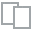
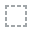
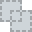
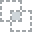
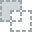
...
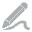
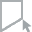
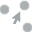
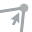
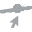

In [31]:
from dataprep.eda import plot_missing
plot_missing(good)

In [30]:
dislike = pd.read_csv('dislike.csv')

In [31]:
drop_col = ['Unnamed: 0', 'type', 'uri', 'track_href', 'analysis_url']
for x in drop_col:
    dislike.drop(x, axis=1, inplace=True)

In [32]:
dislike

,id,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,4pFC6tuWErxbO61oFFq3BQ,0.357,0.980,6,-6.835,1,0.0790,0.000052,0.843000,0.0768,0.368,96.969,242760,4
1,6V3SNkvi4BnfmZU0j7s9TQ,0.446,0.977,10,-5.036,0,0.0781,0.000535,0.472000,0.1050,0.339,172.059,284400,4
2,1Ds58cpyJzL0YTKk02vh1C,0.291,0.980,1,-5.138,1,0.1530,0.001270,0.091000,0.1020,0.257,79.792,270920,4
3,77QKNMGwlnzxsTZPYfByMu,0.462,0.974,1,-5.820,1,0.0816,0.000029,0.723000,0.0751,0.399,107.877,186576,3
4,3bQoMbPYOvvseHaSOWAQ3Q,0.338,0.988,8,-7.290,0,0.0865,0.000083,0.833000,0.0377,0.449,99.046,221960,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
90,1QqsAlhs7pxcXs9BMB1Nv5,0.759,0.612,10,-12.053,1,0.0339,0.024000,0.429000,0.1060,0.947,128.570,656760,4
91,6VuIKS2Z27jCutIapgCUZF,0.651,0.811,10,-13.870,1,0.0318,0.064800,0.029300,0.1000,0.962,112.126,186573,4
92,7sMGwiS4vOMcz86ZY3vKYM,0.705,0.847,6,-2.588,1,0.0361,0.414000,0.000003,0.4060,0.743,120.527,228120,4
93,4JsQkSOE4taeyhH3pv1een,0.819,0.811,6,-7.760,0,0.0349,0.203000,0.005580,0.1390,0.766,106.684,246760,4


In [33]:
dislike.insert(14, 'liking', 0)

In [34]:
dislike

,id,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,liking
0,4pFC6tuWErxbO61oFFq3BQ,0.357,0.980,6,-6.835,1,0.0790,0.000052,0.843000,0.0768,0.368,96.969,242760,4,0
1,6V3SNkvi4BnfmZU0j7s9TQ,0.446,0.977,10,-5.036,0,0.0781,0.000535,0.472000,0.1050,0.339,172.059,284400,4,0
2,1Ds58cpyJzL0YTKk02vh1C,0.291,0.980,1,-5.138,1,0.1530,0.001270,0.091000,0.1020,0.257,79.792,270920,4,0
3,77QKNMGwlnzxsTZPYfByMu,0.462,0.974,1,-5.820,1,0.0816,0.000029,0.723000,0.0751,0.399,107.877,186576,3,0
4,3bQoMbPYOvvseHaSOWAQ3Q,0.338,0.988,8,-7.290,0,0.0865,0.000083,0.833000,0.0377,0.449,99.046,221960,4,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
90,1QqsAlhs7pxcXs9BMB1Nv5,0.759,0.612,10,-12.053,1,0.0339,0.024000,0.429000,0.1060,0.947,128.570,656760,4,0
91,6VuIKS2Z27jCutIapgCUZF,0.651,0.811,10,-13.870,1,0.0318,0.064800,0.029300,0.1000,0.962,112.126,186573,4,0
92,7sMGwiS4vOMcz86ZY3vKYM,0.705,0.847,6,-2.588,1,0.0361,0.414000,0.000003,0.4060,0.743,120.527,228120,4,0
93,4JsQkSOE4taeyhH3pv1een,0.819,0.811,6,-7.760,0,0.0349,0.203000,0.005580,0.1390,0.766,106.684,246760,4,0


In [35]:
dislike.describe()

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,liking
count,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.0
mean,0.510021,0.590128,5.652632,-12.260474,0.526316,0.076097,0.377909,0.394811,0.149894,0.419836,110.417821,249653.263158,3.810526,0.0
std,0.226971,0.334915,3.331885,8.200436,0.501956,0.055873,0.388127,0.408854,0.115315,0.318535,25.950603,79318.272078,0.570456,0.0
min,0.130000,0.002400,0.000000,-42.261000,0.000000,0.027800,0.000003,0.000000,0.033100,0.035300,60.171000,123880.000000,1.000000,0.0
25%,0.294000,0.376000,2.000000,-13.845000,0.000000,0.041500,0.001365,0.000125,0.080800,0.142500,95.480000,208600.000000,4.000000,0.0
50%,0.463000,0.624000,6.000000,-9.223000,1.000000,0.059500,0.231000,0.261000,0.102000,0.334000,108.628000,241187.000000,4.000000,0.0
75%,0.713500,0.926000,8.000000,-7.227500,1.000000,0.092700,0.759500,0.866500,0.175000,0.762000,125.975000,271957.500000,4.000000,0.0
max,0.909000,0.996000,11.000000,-2.588000,1.000000,0.444000,0.995000,0.969000,0.633000,0.980000,179.661000,656760.000000,5.000000,0.0


In [36]:
dislike.nunique()

id                  95
danceability        90
energy              86
key                 12
loudness            95
mode                 2
speechiness         92
acousticness        87
instrumentalness    83
liveness            85
valence             90
tempo               95
duration_ms         94
time_signature       4
liking               1
dtype: int64

  0%|          | 0/182 [00:00<?, ?it/s]


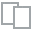
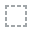
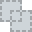
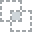
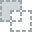
...
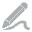
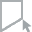
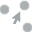
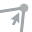
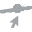

In [39]:
from dataprep.eda import plot_missing
plot_missing(dislike)

In [37]:
data = pd.concat([good, dislike])
data

,id,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,liking
0,55mcupbf7cIsuCEVAuTJVk,0.749,0.839,6,-4.847,1,0.2970,0.0867,0.000000,0.2040,0.804,172.068,111000,4,1
1,57RtLWT7IpugV0yi5bsxJk,0.573,0.581,10,-9.026,0,0.3390,0.7530,0.000001,0.1300,0.351,76.506,169347,4,1
2,5VyfAfp2Yt3qaeuvq55ll3,0.800,0.719,7,-6.262,1,0.2340,0.1090,0.000000,0.0580,0.815,143.975,230854,4,1
3,3eWHY75nDgte70hh5yf4UW,0.778,0.632,8,-6.415,1,0.1250,0.0404,0.000000,0.0912,0.827,140.951,224029,4,1
4,2UwrB6Ge6mPfUV8yGvAfX7,0.797,0.852,8,-5.202,1,0.2410,0.0555,0.000024,0.0536,0.480,136.035,102353,4,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
90,1QqsAlhs7pxcXs9BMB1Nv5,0.759,0.612,10,-12.053,1,0.0339,0.0240,0.429000,0.1060,0.947,128.570,656760,4,0
91,6VuIKS2Z27jCutIapgCUZF,0.651,0.811,10,-13.870,1,0.0318,0.0648,0.029300,0.1000,0.962,112.126,186573,4,0
92,7sMGwiS4vOMcz86ZY3vKYM,0.705,0.847,6,-2.588,1,0.0361,0.4140,0.000003,0.4060,0.743,120.527,228120,4,0
93,4JsQkSOE4taeyhH3pv1een,0.819,0.811,6,-7.760,0,0.0349,0.2030,0.005580,0.1390,0.766,106.684,246760,4,0


In [107]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 195 entries, 0 to 194
Data columns (total 15 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   id                195 non-null    object 
 1   danceability      195 non-null    float64
 2   energy            195 non-null    float64
 3   key               195 non-null    int64  
 4   loudness          195 non-null    float64
 5   mode              195 non-null    int64  
 6   speechiness       195 non-null    float64
 7   acousticness      195 non-null    float64
 8   instrumentalness  195 non-null    float64
 9   liveness          195 non-null    float64
 10  valence           195 non-null    float64
 11  tempo             195 non-null    float64
 12  duration_ms       195 non-null    int64  
 13  time_signature    195 non-null    int64  
 14  liking            195 non-null    int64  
dtypes: float64(9), int64(5), object(1)
memory usage: 23.0+ KB


## MySQL

In [99]:
connection = con.connect(host='localhost', database='pace_sca_db', user='root', password='Tiger')
cursor = connection.cursor()

In [122]:
sql = "insert into spotify_data values(%s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s)"
for x in range(len(data)):
    val = (data.iloc[x][0], data.iloc[x][1], data.iloc[x][2], int(data.iloc[x][3]), data.iloc[x][4], int(data.iloc[x][5]), data.iloc[x][6], data.iloc[x][7], data.iloc[x][8], data.iloc[x][9], data.iloc[x][10], data.iloc[x][11], int(data.iloc[x][12]), int(data.iloc[x][13]), int(data.iloc[x][14]))
    cursor.execute(sql, val)
    print(val)
connection.commit()

('55mcupbf7cIsuCEVAuTJVk', 0.749, 0.839, 6, -4.847, 1, 0.297, 0.0867, 0.0, 0.204, 0.804, 172.068, 111000, 4, 1)
('57RtLWT7IpugV0yi5bsxJk', 0.573, 0.581, 10, -9.026, 0, 0.339, 0.753, 1.39e-06, 0.13, 0.351, 76.506, 169347, 4, 1)
('5VyfAfp2Yt3qaeuvq55ll3', 0.8, 0.719, 7, -6.262, 1, 0.234, 0.109, 0.0, 0.058, 0.815, 143.975, 230854, 4, 1)
('3eWHY75nDgte70hh5yf4UW', 0.778, 0.632, 8, -6.415, 1, 0.125, 0.0404, 0.0, 0.0912, 0.827, 140.951, 224029, 4, 1)
('2UwrB6Ge6mPfUV8yGvAfX7', 0.797, 0.852, 8, -5.202, 1, 0.241, 0.0555, 2.45e-05, 0.0536, 0.48, 136.035, 102353, 4, 1)
('4HolRqFuNvTvoLR2l1gexi', 0.743, 0.663, 2, -8.47, 1, 0.0507, 0.0148, 0.000666, 0.393, 0.415, 132.012, 100000, 4, 1)
('6dS1JCvtMJQ1O9bseVLyJz', 0.915, 0.551, 8, -10.49, 1, 0.343, 0.0342, 0.0, 0.102, 0.753, 124.906, 88320, 4, 1)
('3zCWbPJVp1egCgyoMYAsDN', 0.798, 0.835, 9, -3.832, 1, 0.202, 0.165, 0.0, 0.112, 0.609, 150.04, 139240, 4, 1)
('0O4U6fVE1TwWYhM4fKr1Fh', 0.827, 0.804, 9, -5.846, 1, 0.128, 0.455, 1.41e-06, 0.272, 0.566, 146

('5JIeLpAbKtpFrCSWeOAiwo', 0.853, 0.668, 3, -6.995, 1, 0.447, 0.263, 0.0, 0.104, 0.745, 157.995, 165363, 4, 1)
('7tN7t8ECFVrExNd3qaqT3u', 0.689, 0.68, 7, -6.551, 0, 0.0774, 0.392, 1.22e-06, 0.107, 0.567, 75.445, 168574, 4, 1)
('2EMTOyiYWGOIS3qg5jkcQT', 0.7, 0.719, 5, -6.12, 1, 0.09, 0.725, 0.0, 0.116, 0.429, 143.971, 149013, 4, 1)
('6KigD0mlF4VGDYiSEzAyYw', 0.716, 0.946, 1, -3.412, 1, 0.261, 0.094, 6.63e-05, 0.0825, 0.587, 139.943, 200571, 4, 1)
('66ks5ll4gswiaE7lfb2QMz', 0.875, 0.474, 1, -8.24, 1, 0.276, 0.3, 1.07e-06, 0.113, 0.558, 138.027, 146480, 4, 1)
('7gi31ULI4vzNFUw8pokrfm', 0.829, 0.708, 10, -5.05, 1, 0.102, 0.329, 0.0, 0.093, 0.723, 139.961, 203813, 4, 1)
('7Khbx8MgVTwIJe8YBi8tci', 0.75, 0.758, 6, -7.112, 0, 0.261, 0.318, 0.0, 0.156, 0.538, 131.001, 207907, 4, 1)
('2o7n4nINXpjbo9VpsHZ8Ik', 0.908, 0.61, 9, -5.735, 1, 0.271, 0.213, 3.36e-05, 0.241, 0.443, 140.006, 197613, 4, 1)
('4QMaRC93F0aFx3S648CLyh', 0.506, 0.881, 5, -5.491, 0, 0.108, 0.000163, 0.00143, 0.23, 0.556, 148.084

('1mlLOJXeUrwviYpUHYeZE8', 0.191, 0.0317, 9, -35.616, 0, 0.0407, 0.984, 0.888, 0.0974, 0.142, 135.974, 150733, 3, 0)
('0OrZXWjGgGUuoIoqnLvtJN', 0.379, 0.075, 0, -20.328, 1, 0.0408, 0.992, 0.913, 0.106, 0.0353, 68.232, 241187, 3, 0)
('3QPPP2YozZ5xmMmpDB3c9n', 0.166, 0.0551, 9, -19.494, 0, 0.052, 0.976, 0.635, 0.119, 0.143, 176.616, 206520, 3, 0)
('1GBUqmdRjScFoG0cs8jEGZ', 0.318, 0.0633, 6, -23.869, 1, 0.0507, 0.992, 0.871, 0.0831, 0.0384, 129.466, 199133, 3, 0)
('4XJXYvjW0CB2MLMk8l7Vdi', 0.456, 0.456, 11, -16.055, 0, 0.0535, 0.973, 0.353, 0.186, 0.974, 144.489, 210680, 3, 0)
('5xm20JNLHy9vUVrnmZS6Uj', 0.307, 0.0515, 4, -28.493, 0, 0.0324, 0.708, 0.631, 0.42, 0.154, 128.056, 125533, 4, 0)
('7KrdT8Zk0WGeyNtaCwQR08', 0.235, 0.365, 7, -13.864, 1, 0.0356, 0.927, 0.907, 0.17, 0.126, 91.187, 183667, 3, 0)
('6yjpji2Jlie9S2zBm2GZwE', 0.263, 0.202, 1, -17.687, 1, 0.0408, 0.984, 0.905, 0.089, 0.12, 71.462, 545747, 4, 0)
('5nNmj1cLH3r4aA4XDJ2bgY', 0.697, 0.809, 9, -8.197, 1, 0.0302, 0.114, 0.000521

---

In [38]:
data = data.reset_index(drop=True)

In [39]:
data['time_signature'].value_counts()

4    170
3     17
5      6
1      2
Name: time_signature, dtype: int64

In [40]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 195 entries, 0 to 194
Data columns (total 15 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   id                195 non-null    object 
 1   danceability      195 non-null    float64
 2   energy            195 non-null    float64
 3   key               195 non-null    int64  
 4   loudness          195 non-null    float64
 5   mode              195 non-null    int64  
 6   speechiness       195 non-null    float64
 7   acousticness      195 non-null    float64
 8   instrumentalness  195 non-null    float64
 9   liveness          195 non-null    float64
 10  valence           195 non-null    float64
 11  tempo             195 non-null    float64
 12  duration_ms       195 non-null    int64  
 13  time_signature    195 non-null    int64  
 14  liking            195 non-null    int64  
dtypes: float64(9), int64(5), object(1)
memory usage: 23.0+ KB


In [41]:
data.isnull().sum()

id                  0
danceability        0
energy              0
key                 0
loudness            0
mode                0
speechiness         0
acousticness        0
instrumentalness    0
liveness            0
valence             0
tempo               0
duration_ms         0
time_signature      0
liking              0
dtype: int64

In [42]:
data.duplicated().sum()

0

In [43]:
out_lir_feat = ['danceability', 'energy', 'key', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo']

In [44]:
# good
for x in out_lir_feat:
    temp = good[x].tolist()
    q1 = np.percentile(temp, 25, interpolation='midpoint')
    q3 = np.percentile(temp, 75, interpolation='midpoint')
    IQR = q3 - q1
    upper = np.where(temp >= (q3+1.5*IQR))
    lower = np.where(temp <= (q1-1.5*IQR))
    print('for column: ',x,'\n',upper, lower,'\n#########################################\n')

for column:  danceability 
 (array([], dtype=int64),) (array([34, 93, 94], dtype=int64),) 
#########################################

for column:  energy 
 (array([], dtype=int64),) (array([], dtype=int64),) 
#########################################

for column:  key 
 (array([], dtype=int64),) (array([], dtype=int64),) 
#########################################

for column:  speechiness 
 (array([], dtype=int64),) (array([], dtype=int64),) 
#########################################

for column:  acousticness 
 (array([], dtype=int64),) (array([], dtype=int64),) 
#########################################

for column:  instrumentalness 
 (array([ 4,  5, 10, 20, 32, 34, 40, 41, 48, 51, 55, 64, 75, 76, 83, 87, 88,
       89, 90, 96], dtype=int64),) (array([], dtype=int64),) 
#########################################

for column:  liveness 
 (array([ 5, 14, 19, 21, 32, 34, 42, 63, 70, 79, 93], dtype=int64),) (array([], dtype=int64),) 
#########################################

for column:

In [45]:
# dislike
for x in out_lir_feat:
    temp = dislike[x].tolist()
    q1 = np.percentile(temp, 25, interpolation='midpoint')
    q3 = np.percentile(temp, 75, interpolation='midpoint')
    IQR = q3 - q1
    upper = np.where(temp >= (q3+1.5*IQR))
    lower = np.where(temp <= (q1-1.5*IQR))
    print('for column: ',x,'\n',upper, lower,'\n#########################################\n')

for column:  danceability 
 (array([], dtype=int64),) (array([], dtype=int64),) 
#########################################

for column:  energy 
 (array([], dtype=int64),) (array([], dtype=int64),) 
#########################################

for column:  key 
 (array([], dtype=int64),) (array([], dtype=int64),) 
#########################################

for column:  speechiness 
 (array([ 9, 19, 28, 32, 39], dtype=int64),) (array([], dtype=int64),) 
#########################################

for column:  acousticness 
 (array([], dtype=int64),) (array([], dtype=int64),) 
#########################################

for column:  instrumentalness 
 (array([], dtype=int64),) (array([], dtype=int64),) 
#########################################

for column:  liveness 
 (array([10, 17, 18, 19, 24, 46, 61, 67, 75, 77, 85, 92, 94], dtype=int64),) (array([], dtype=int64),) 
#########################################

for column:  valence 
 (array([], dtype=int64),) (array([], dtype=int64),) 
####

In [46]:
# concat
for x in out_lir_feat:
    temp = data[x].tolist()
    q1 = np.percentile(temp, 25, interpolation='midpoint')
    q3 = np.percentile(temp, 75, interpolation='midpoint')
    IQR = q3 - q1
    upper = np.where(temp >= (q3+1.5*IQR))
    lower = np.where(temp <= (q1-1.5*IQR))
    print('for column: ',x,'\n',upper, lower,'\n#########################################\n')

for column:  danceability 
 (array([], dtype=int64),) (array([], dtype=int64),) 
#########################################

for column:  energy 
 (array([], dtype=int64),) (array([145, 147, 148, 149, 150, 151, 153, 155, 158, 160, 162, 163, 164,
       165, 167], dtype=int64),) 
#########################################

for column:  key 
 (array([], dtype=int64),) (array([], dtype=int64),) 
#########################################

for column:  speechiness 
 (array([58, 59, 79], dtype=int64),) (array([], dtype=int64),) 
#########################################

for column:  acousticness 
 (array([], dtype=int64),) (array([], dtype=int64),) 
#########################################

for column:  instrumentalness 
 (array([100, 101, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113,
       114, 115, 116, 117, 118, 119, 121, 122, 123, 124, 145, 146, 147,
       148, 149, 150, 151, 153, 154, 155, 157, 158, 159, 160, 161, 162,
       163, 164, 165, 166, 167, 168, 169, 176, 190], dtyp

In [75]:
data['instrumentalness'].describe()

count    195.000000
mean       0.192686
std        0.346431
min        0.000000
25%        0.000000
50%        0.000008
75%        0.097500
max        0.969000
Name: instrumentalness, dtype: float64

In [76]:
data[data['instrumentalness'] >= 0.09]

,id,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,liking
100,4pFC6tuWErxbO61oFFq3BQ,0.357,0.98000,6,-6.835,1,0.0790,0.000052,0.843,0.0768,0.3680,96.969,242760,4,0
101,6V3SNkvi4BnfmZU0j7s9TQ,0.446,0.97700,10,-5.036,0,0.0781,0.000535,0.472,0.1050,0.3390,172.059,284400,4,0
102,1Ds58cpyJzL0YTKk02vh1C,0.291,0.98000,1,-5.138,1,0.1530,0.001270,0.091,0.1020,0.2570,79.792,270920,4,0
103,77QKNMGwlnzxsTZPYfByMu,0.462,0.97400,1,-5.820,1,0.0816,0.000029,0.723,0.0751,0.3990,107.877,186576,3,0
104,3bQoMbPYOvvseHaSOWAQ3Q,0.338,0.98800,8,-7.290,0,0.0865,0.000083,0.833,0.0377,0.4490,99.046,221960,4,0
105,1sWcWDgthOikmqaHdfTfW2,0.256,0.95200,7,-8.631,0,0.1030,0.000022,0.587,0.1350,0.0724,144.481,206120,4,0
106,10nOWGyxyXW42t9NH6BNSS,0.373,0.98000,1,-5.016,0,0.1220,0.000319,0.906,0.1050,0.3400,97.346,211947,4,0
107,5WGvXmLt6acluR7TfhlHUH,0.130,0.94700,8,-5.888,1,0.0950,0.000024,0.368,0.0453,0.3340,60.631,272995,4,0
108,4YWg4PxJzMn84j7Fo32W4M,0.225,0.98000,6,-5.626,1,0.1430,0.000006,0.860,0.0653,0.1050,115.077,285907,4,0
109,6m5EVmAlKhJwbQCT3xN5Kt,0.571,0.99600,10,-4.907,0,0.2150,0.000049,0.601,0.1870,0.0468,94.992,211693,4,0


In [96]:
# energy > 0.5
# loudness > -10
# dancability > 0.5

temp = data[data['liking']==1]
temp2 = temp[temp['energy']>=0.5]
temp3 = temp2[temp2['loudness']>= -10]
temp3[temp3['danceability'] >= 0.5]

,id,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,liking
0,55mcupbf7cIsuCEVAuTJVk,0.749,0.839,6,-4.847,1,0.2970,0.08670,0.000000,0.2040,0.804,172.068,111000,4,1
1,57RtLWT7IpugV0yi5bsxJk,0.573,0.581,10,-9.026,0,0.3390,0.75300,0.000001,0.1300,0.351,76.506,169347,4,1
2,5VyfAfp2Yt3qaeuvq55ll3,0.800,0.719,7,-6.262,1,0.2340,0.10900,0.000000,0.0580,0.815,143.975,230854,4,1
3,3eWHY75nDgte70hh5yf4UW,0.778,0.632,8,-6.415,1,0.1250,0.04040,0.000000,0.0912,0.827,140.951,224029,4,1
4,2UwrB6Ge6mPfUV8yGvAfX7,0.797,0.852,8,-5.202,1,0.2410,0.05550,0.000024,0.0536,0.480,136.035,102353,4,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91,2UREu1Y8CO4jXkbvqAtP7g,0.640,0.957,8,-2.336,1,0.0741,0.04310,0.000000,0.0789,0.692,134.992,178013,4,1
92,0i8JFpqe9cKwnrcvoNgl1L,0.603,0.886,5,-3.777,0,0.0837,0.00045,0.000000,0.2600,0.395,126.025,229933,4,1
96,3DWDcsDoXRIFynCREIkibM,0.802,0.549,5,-8.600,0,0.0631,0.26800,0.004960,0.0984,0.498,138.984,184627,4,1
97,6fmtZEUoGwxPNvUgr0NJm1,0.767,0.659,7,-4.541,1,0.0387,0.78500,0.000000,0.1120,0.631,90.056,186720,4,1


In [82]:
data[data['liking']==1]['instrumentalness']>=0.09

0     False
1     False
2     False
3     False
4     False
      ...  
95    False
96    False
97    False
98    False
99    False
Name: instrumentalness, Length: 100, dtype: bool

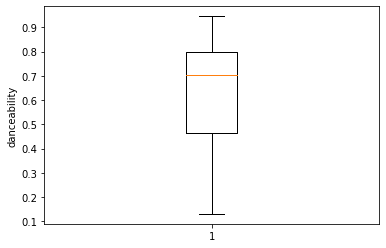

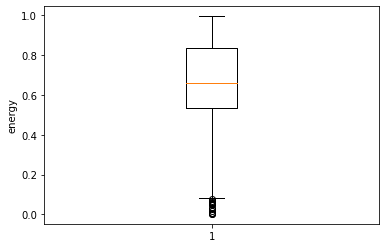

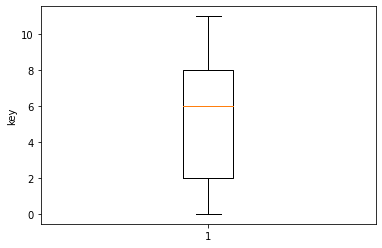

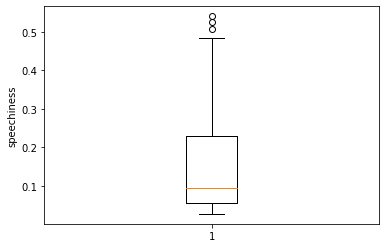

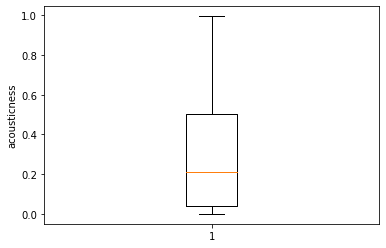

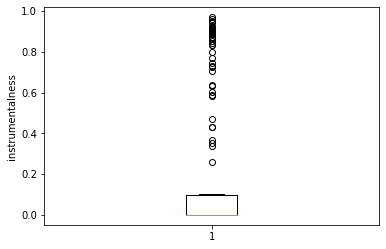

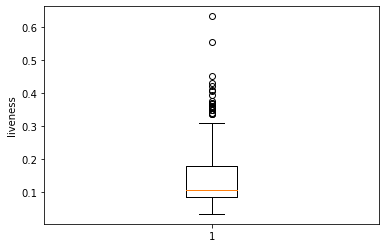

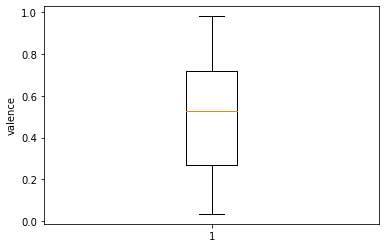

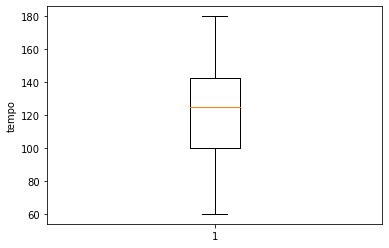

In [50]:
cols = []
for x in out_lir_feat:
    temp = data[x].tolist()
    #cols.append(temp)
    plt.boxplot(temp)
    plt.ylabel(x)
    plt.show()
#plt.xticks([x for x in range(len(out_lir_feat))],[out_lir_feat])

In [47]:
data['instrumentalness'].describe()

count    195.000000
mean       0.192686
std        0.346431
min        0.000000
25%        0.000000
50%        0.000008
75%        0.097500
max        0.969000
Name: instrumentalness, dtype: float64

In [48]:
dislike.sort_values(by=['instrumentalness'], ascending=False)

,id,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,liking
45,3U8Fx7zNTQrctytkj6Gqgd,0.213,0.06560,7,-24.810,1,0.0467,0.992,0.969,0.0699,0.0384,65.023,150147,3,0
57,1BncfTJAWxrsxyT9culBrj,0.447,0.44900,2,-10.634,1,0.0376,0.934,0.961,0.0697,0.0360,92.468,315427,4,0
50,64LTn5fTsPR0QLy7bVYl9w,0.334,0.00732,4,-30.908,0,0.0355,0.991,0.952,0.0968,0.0964,60.171,241987,4,0
54,7N2tmiKcG2bUgZkuRKXor4,0.205,0.12900,7,-18.197,1,0.0595,0.968,0.946,0.1010,0.2960,136.871,169924,4,0
60,0H2VhGUC3P3hvwz8rdGIpC,0.230,0.04870,5,-27.675,1,0.0412,0.986,0.945,0.0679,0.1010,134.839,203656,5,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34,5n9NAd0Y5OUeOGU0nVtLua,0.745,0.45600,8,-9.482,1,0.0874,0.440,0.000,0.0720,0.1240,94.032,314367,4,0
41,2jBleFNl3YK8lyJc1OvxXt,0.762,0.60000,5,-7.585,0,0.0909,0.542,0.000,0.0841,0.3900,115.908,352627,4,0
32,0vfB1HhL36tfV8q6LLKtgo,0.539,0.48700,1,-9.653,1,0.2020,0.309,0.000,0.0970,0.3750,169.985,186353,4,0
31,00X2yv2vrtritPt2CZnUTZ,0.784,0.70000,7,-7.649,0,0.1080,0.491,0.000,0.1080,0.7690,82.028,190067,4,0


In [49]:
cor = data.corr()
cor

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,liking
danceability,1.000000,0.135441,-0.065169,0.453548,0.042928,0.389845,-0.233520,-0.806946,-0.135619,0.611260,0.223412,-0.238224,0.317109,0.570722
energy,0.135441,1.000000,0.126803,0.813544,-0.070790,0.125475,-0.770433,-0.242795,0.168532,0.315093,0.214288,-0.150760,0.123481,0.178972
key,-0.065169,0.126803,1.000000,0.043294,-0.103371,-0.093258,-0.066973,0.004929,-0.037369,0.032902,0.097244,0.054631,0.048344,-0.044406
loudness,0.453548,0.813544,0.043294,1.000000,-0.044153,0.282232,-0.662226,-0.539466,0.079453,0.359016,0.273647,-0.222661,0.207212,0.413388
mode,0.042928,-0.070790,-0.103371,-0.044153,1.000000,0.032059,-0.025801,0.076331,-0.047104,0.033130,-0.036267,-0.060822,-0.110739,0.023747
speechiness,0.389845,0.125475,-0.093258,0.282232,0.032059,1.000000,-0.079713,-0.343989,-0.008416,0.181385,0.313978,-0.387600,0.140361,0.591455
acousticness,-0.233520,-0.770433,-0.066973,-0.662226,-0.025801,-0.079713,1.000000,0.293138,-0.142637,-0.313828,-0.255103,0.137956,-0.142183,-0.179253
instrumentalness,-0.806946,-0.242795,0.004929,-0.539466,0.076331,-0.343989,0.293138,1.000000,0.056191,-0.570683,-0.299044,0.255633,-0.374782,-0.570139
liveness,-0.135619,0.168532,-0.037369,0.079453,-0.047104,-0.008416,-0.142637,0.056191,1.000000,-0.009829,-0.010105,-0.133420,-0.135208,-0.011586
valence,0.611260,0.315093,0.032902,0.359016,0.033130,0.181385,-0.313828,-0.570683,-0.009829,1.000000,0.218075,-0.116776,0.201165,0.269194


<AxesSubplot:>

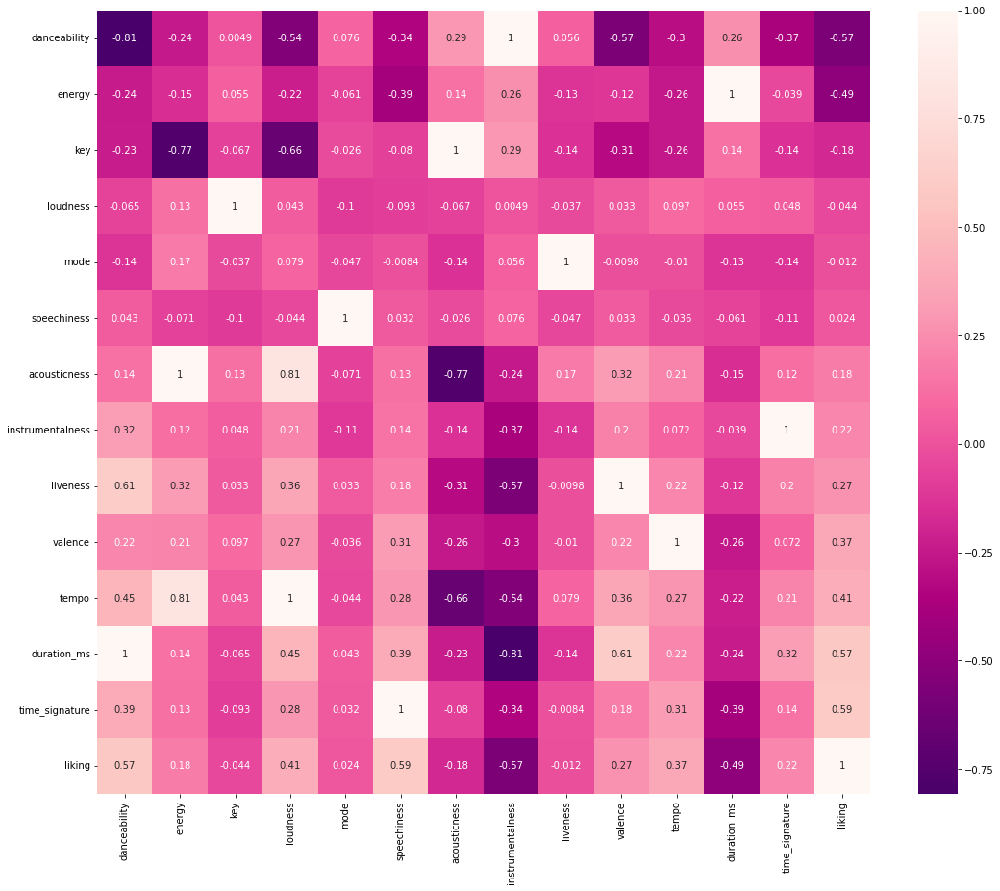

In [88]:
plt.figure(figsize = (18,15))
sns.heatmap(cor, xticklabels=data.columns[1:], yticklabels=data.columns[1:], annot=True, cmap = 'RdPu_r')

In [51]:
cor = cor.sort_values(by=['liking'])
cor

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,liking
instrumentalness,-0.806946,-0.242795,0.004929,-0.539466,0.076331,-0.343989,0.293138,1.000000,0.056191,-0.570683,-0.299044,0.255633,-0.374782,-0.570139
duration_ms,-0.238224,-0.150760,0.054631,-0.222661,-0.060822,-0.387600,0.137956,0.255633,-0.133420,-0.116776,-0.256027,1.000000,-0.039030,-0.490431
acousticness,-0.233520,-0.770433,-0.066973,-0.662226,-0.025801,-0.079713,1.000000,0.293138,-0.142637,-0.313828,-0.255103,0.137956,-0.142183,-0.179253
key,-0.065169,0.126803,1.000000,0.043294,-0.103371,-0.093258,-0.066973,0.004929,-0.037369,0.032902,0.097244,0.054631,0.048344,-0.044406
liveness,-0.135619,0.168532,-0.037369,0.079453,-0.047104,-0.008416,-0.142637,0.056191,1.000000,-0.009829,-0.010105,-0.133420,-0.135208,-0.011586
mode,0.042928,-0.070790,-0.103371,-0.044153,1.000000,0.032059,-0.025801,0.076331,-0.047104,0.033130,-0.036267,-0.060822,-0.110739,0.023747
energy,0.135441,1.000000,0.126803,0.813544,-0.070790,0.125475,-0.770433,-0.242795,0.168532,0.315093,0.214288,-0.150760,0.123481,0.178972
time_signature,0.317109,0.123481,0.048344,0.207212,-0.110739,0.140361,-0.142183,-0.374782,-0.135208,0.201165,0.071754,-0.039030,1.000000,0.221479
valence,0.611260,0.315093,0.032902,0.359016,0.033130,0.181385,-0.313828,-0.570683,-0.009829,1.000000,0.218075,-0.116776,0.201165,0.269194
tempo,0.223412,0.214288,0.097244,0.273647,-0.036267,0.313978,-0.255103,-0.299044,-0.010105,0.218075,1.000000,-0.256027,0.071754,0.371199


In [52]:
cor['liking']

instrumentalness   -0.570139
duration_ms        -0.490431
acousticness       -0.179253
key                -0.044406
liveness           -0.011586
mode                0.023747
energy              0.178972
time_signature      0.221479
valence             0.269194
tempo               0.371199
loudness            0.413388
danceability        0.570722
speechiness         0.591455
liking              1.000000
Name: liking, dtype: float64

In [53]:
high_coor = ['instrumentalness', 'duration_ms', 'acousticness', 'energy', 'time_signature', 'valence', 'tempo', 'loudness', 'danceability', 'speechiness', 'liking']

In [54]:
short_data = data[high_coor].copy()
short_data

,instrumentalness,duration_ms,acousticness,energy,time_signature,valence,tempo,loudness,danceability,speechiness,liking
0,0.000000,111000,0.0867,0.839,4,0.804,172.068,-4.847,0.749,0.2970,1
1,0.000001,169347,0.7530,0.581,4,0.351,76.506,-9.026,0.573,0.3390,1
2,0.000000,230854,0.1090,0.719,4,0.815,143.975,-6.262,0.800,0.2340,1
3,0.000000,224029,0.0404,0.632,4,0.827,140.951,-6.415,0.778,0.1250,1
4,0.000024,102353,0.0555,0.852,4,0.480,136.035,-5.202,0.797,0.2410,1
...,...,...,...,...,...,...,...,...,...,...,...
190,0.429000,656760,0.0240,0.612,4,0.947,128.570,-12.053,0.759,0.0339,0
191,0.029300,186573,0.0648,0.811,4,0.962,112.126,-13.870,0.651,0.0318,0
192,0.000003,228120,0.4140,0.847,4,0.743,120.527,-2.588,0.705,0.0361,0
193,0.005580,246760,0.2030,0.811,4,0.766,106.684,-7.760,0.819,0.0349,0


In [55]:
cor_s = short_data.corr()
cor_s

,instrumentalness,duration_ms,acousticness,energy,time_signature,valence,tempo,loudness,danceability,speechiness,liking
instrumentalness,1.000000,0.255633,0.293138,-0.242795,-0.374782,-0.570683,-0.299044,-0.539466,-0.806946,-0.343989,-0.570139
duration_ms,0.255633,1.000000,0.137956,-0.150760,-0.039030,-0.116776,-0.256027,-0.222661,-0.238224,-0.387600,-0.490431
acousticness,0.293138,0.137956,1.000000,-0.770433,-0.142183,-0.313828,-0.255103,-0.662226,-0.233520,-0.079713,-0.179253
energy,-0.242795,-0.150760,-0.770433,1.000000,0.123481,0.315093,0.214288,0.813544,0.135441,0.125475,0.178972
time_signature,-0.374782,-0.039030,-0.142183,0.123481,1.000000,0.201165,0.071754,0.207212,0.317109,0.140361,0.221479
valence,-0.570683,-0.116776,-0.313828,0.315093,0.201165,1.000000,0.218075,0.359016,0.611260,0.181385,0.269194
tempo,-0.299044,-0.256027,-0.255103,0.214288,0.071754,0.218075,1.000000,0.273647,0.223412,0.313978,0.371199
loudness,-0.539466,-0.222661,-0.662226,0.813544,0.207212,0.359016,0.273647,1.000000,0.453548,0.282232,0.413388
danceability,-0.806946,-0.238224,-0.233520,0.135441,0.317109,0.611260,0.223412,0.453548,1.000000,0.389845,0.570722
speechiness,-0.343989,-0.387600,-0.079713,0.125475,0.140361,0.181385,0.313978,0.282232,0.389845,1.000000,0.591455


<AxesSubplot:>

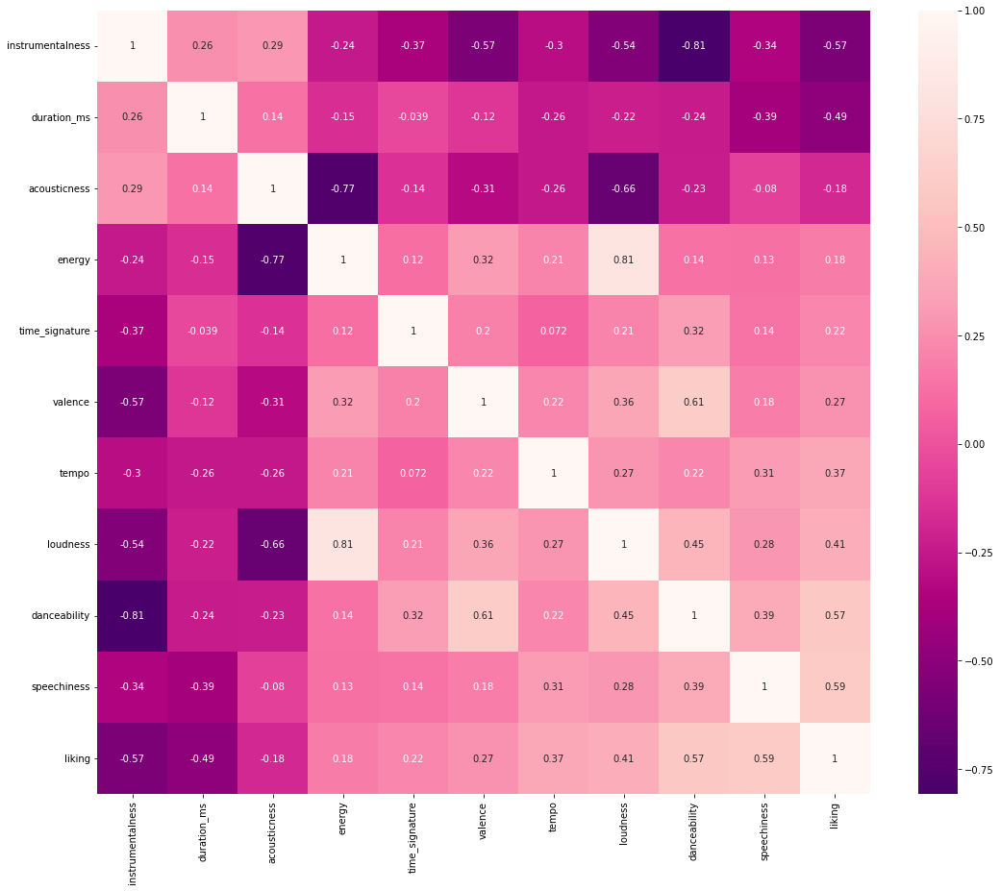

In [87]:
plt.figure(figsize = (18,15))
sns.heatmap(cor_s, xticklabels=cor_s.columns, yticklabels=cor_s.columns, annot=True, cmap = 'RdPu_r')

In [57]:
plot_group_1 = ['energy', 'time_signature', 'valence', 'tempo', 'loudness', 'danceability', 'speechiness']

In [58]:
plot_group_2 = ['instrumentalness', 'duration_ms', 'acousticness']

In [73]:
def scatterprint(*args):
    try: 
        plt.figure(figsize=(6,6))
        sns.scatterplot(data = args[0], x=args[1], y=args[2], hue="liking")
    except Exception as e:
        print("ERROR: ", str(e))
        pass

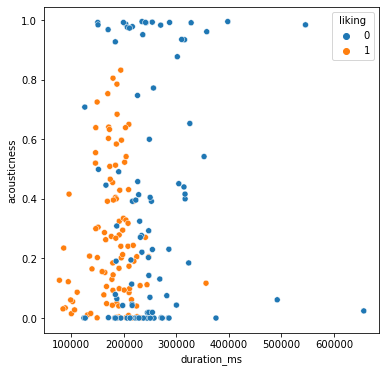

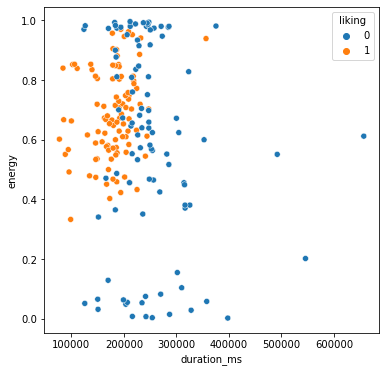

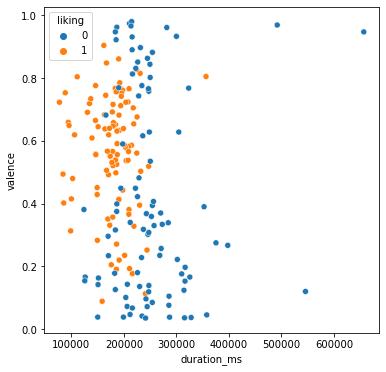

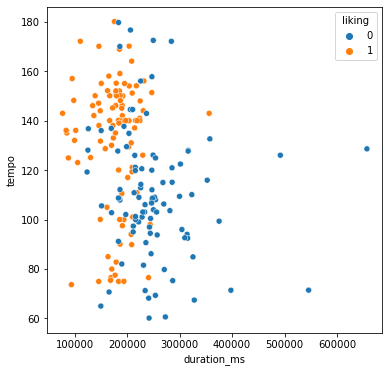

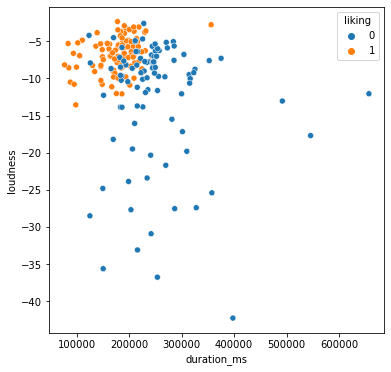

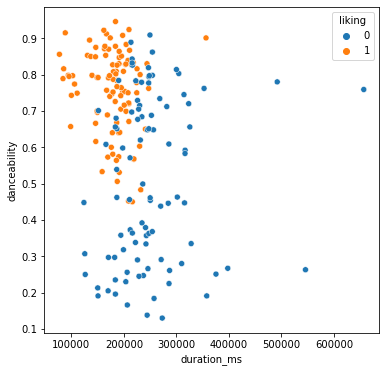

In [74]:
# with duration
right_g = ['acousticness', 'energy', 'valence', 'tempo', 'loudness', 'danceability']
for x in right_g:
    scatterprint(data, 'duration_ms', x)

## OBSERVATIONS:


duration_ms x acousticness 


        - Tom tends to like shorter duration tracks with vayrying levels of acousticness, shorter duration is more important than level of acousticness
    
    
duration_ms x energy 


    - Tom favors high energy (high intensity and activity) and typically shorter duration tracks
    
    
duration_ms x valence 


    - Tom favors shorter duration tracks with varying levels of the valence of the track (musical positiveness), but valence was at least 0.2
    
    
duration_ms x tempo 


    - Tom favors high BPM tracks with varying levels of duration
    
    
duration_ms x loudness 


    - Tom favors very loud tracks over anything else
    
    
duration_ms x danceability 


    - Tom favors tracks with over 0.4 in danceability and typically shorter duration tracks
    

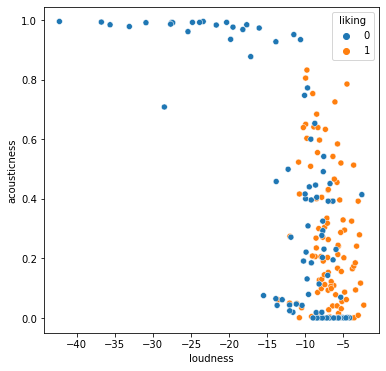

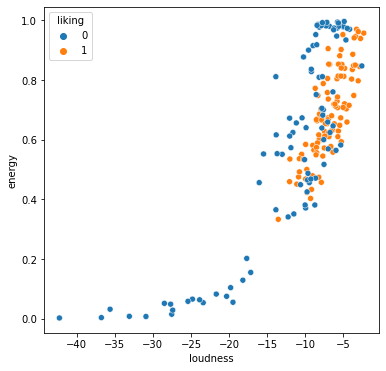

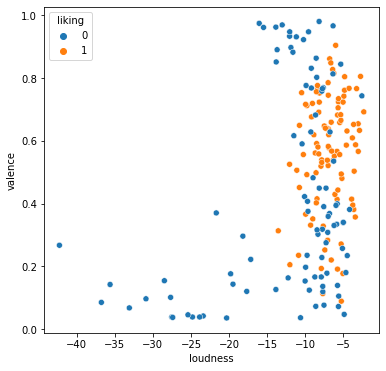

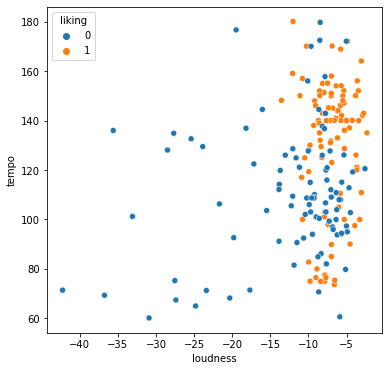

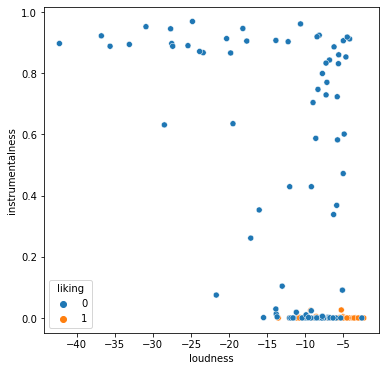

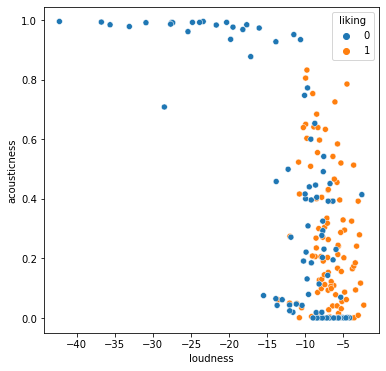

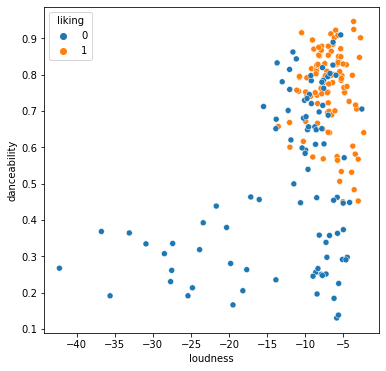

In [61]:
#loudness
right_g = ['acousticness', 'energy', 'valence', 'tempo', 'instrumentalness', 'acousticness', 'danceability']
for x in right_g:
    scatterprint(data, 'loudness', x)

## OBSERVATIONS:


loudness x acousticness


    - Tom favors loudness over acousticness
    
    
loudness x energy 


    - Tom favors songs with high energy and loudness
    
    
loudness x valence


    - Tom favors loud songs irregardless of valence (musical positiveness)
    
    
loudness x tempo


    - Tom favors loud songs irregardless of tempo (bpm)
    
    
loudness x instrumentalness


    - Tom does not care about instrumentals in a track as long as it is loud
    
    
loudness x acousticness


    - Tom does not care about acousticness in a track as long as it is loud
    
    
loudness x danceability


    - Tom favors tracks that are danceable and loud

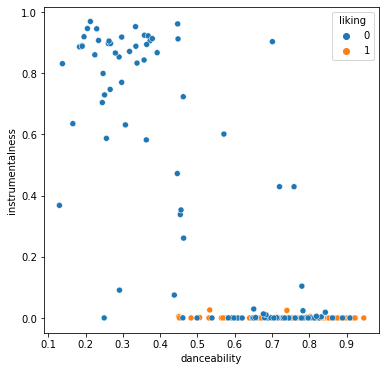

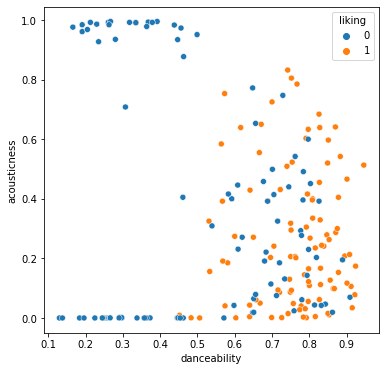

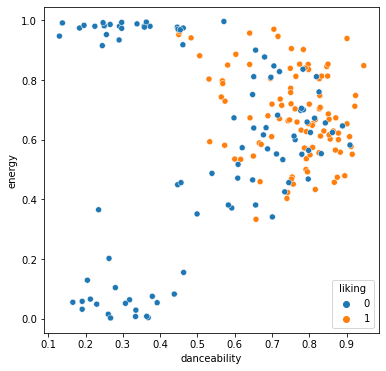

In [62]:
#dancability
right_g = ['instrumentalness', 'acousticness', 'energy']
for x in right_g:
    scatterprint(data, 'danceability', x)

## OBSERVATIONS:


danceability x instrumentalness


    - Tom does not care about instrumentals in a track as long as it is danceable
    
    
danceability x acousticness


    - Tom favors danceability over acousticness
    
    
danceability x energy


    - Tom favors songs with high energy and danceability

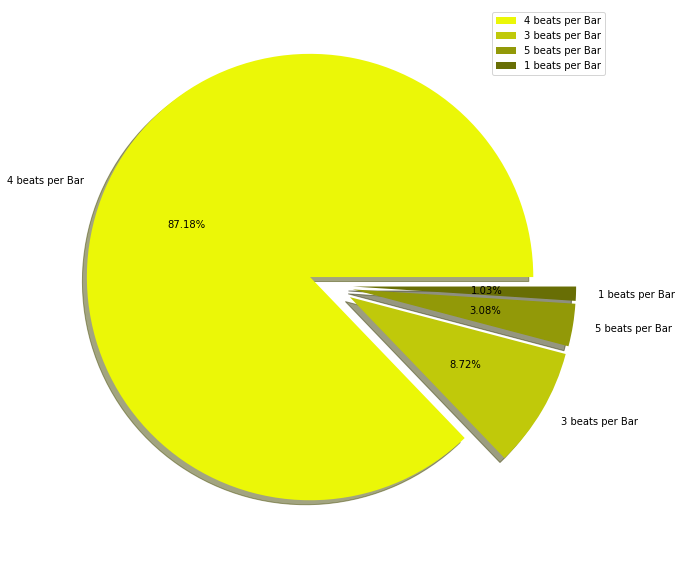

In [63]:
# combined data
plt.figure(figsize= (10, 20))
data_pie  = [170 , 17, 6, 2]
labels = ["4 beats per Bar","3 beats per Bar","5 beats per Bar","1 beats per Bar"]
explode = [0.1, 0.1, 0.1, 0.1]
plt.pie(data_pie ,labels= labels , explode = explode , autopct="%1.2f%%", shadow= True, colors= ['#ebf707','#c0c90a','#929908',
'#686e05'])
plt.legend()
plt.show()

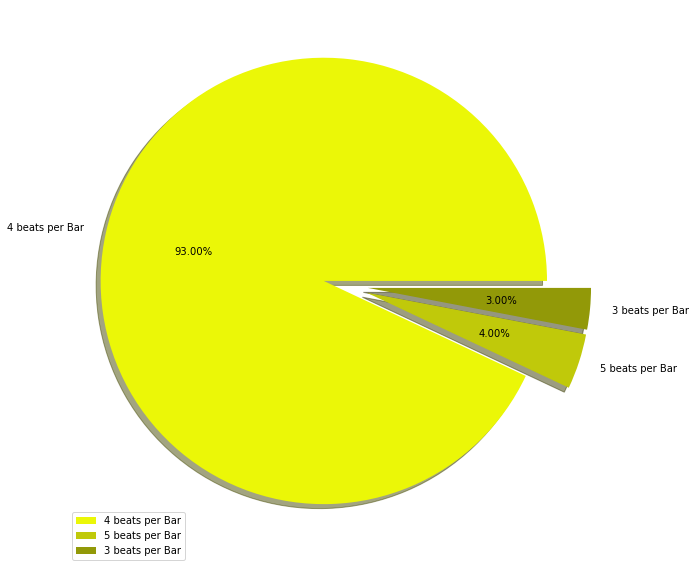

In [68]:
# good songs
plt.figure(figsize= (10, 20))
data_pie  = good['time_signature'].value_counts().tolist()
labels = ["4 beats per Bar","5 beats per Bar","3 beats per Bar"]
explode = [0.1, 0.1, 0.1]
plt.pie(data_pie ,labels= labels , explode = explode , autopct="%1.2f%%", shadow= True, colors= ['#ebf707','#c0c90a','#929908'])
plt.legend()
plt.show()

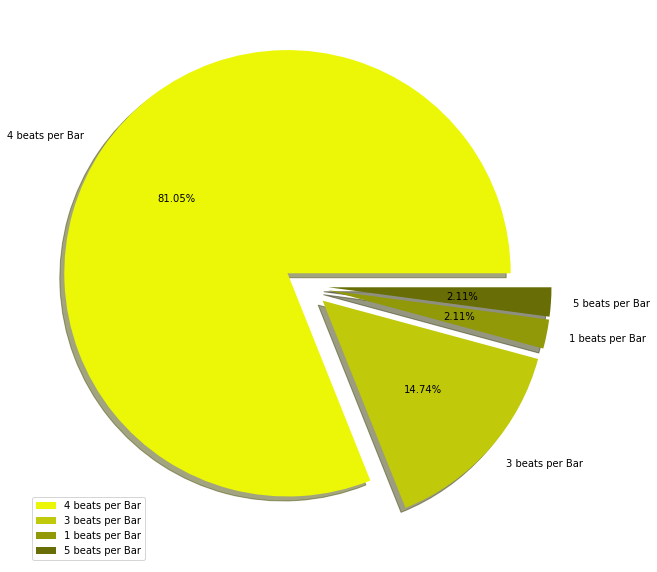

In [71]:
# dislike songs
plt.figure(figsize= (10, 20))
data_pie  = dislike_df['time_signature'].value_counts().tolist()
labels = ["4 beats per Bar","3 beats per Bar","1 beats per Bar", "5 beats per Bar"]
explode = [0.1, 0.1, 0.1, 0.1]
plt.pie(data_pie ,labels= labels , explode = explode , autopct="%1.2f%%", shadow= True, colors= ['#ebf707','#c0c90a','#929908', '#686e05' ])
plt.legend()
plt.show()

## OBSERVATIONS:


    - Out of the disliked and liked tracks, 87.2% of the tracks are 4 beats per bar.
    
    
    - Out of the disliked and liked tracks, 8.7% of the tracks are 3 beats per bar.

    
    - Out of the disliked and liked tracks, 3.1% of the tracks are 5 beats per bar.

    
    - Out of the disliked and liked tracks, 1% of the tracks are 1 beat per bar.

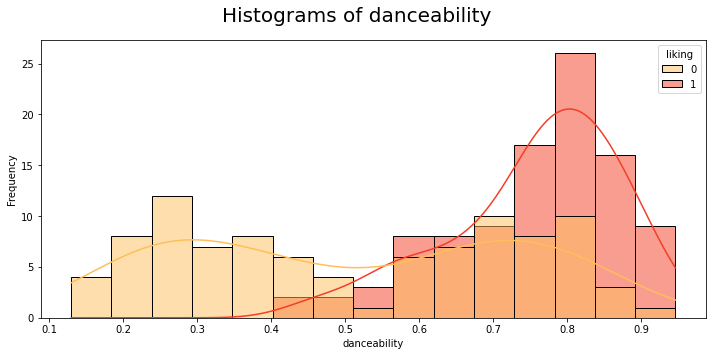

In [69]:
plt.figure(figsize=(10,5))
plt.suptitle('Histograms of danceability', fontsize = 20)
ax1 = sns.histplot(x = data['danceability'],color= 'teal', hue= data['liking'], bins= 15, kde= True, palette= 'YlOrRd')
ax1.set(xlabel= 'danceability', ylabel= 'Frequency')
plt.tight_layout()
plt.show()

## OBSERVATIONS:


    - every liked track ranks at least 0.5 in danceability 
    
    
    - although a track may have high danceability, it is not necessarily liked
    
    
    - disliked tracks has a bimodal shape in danceability
    
    
    - liked tracks are negatively skewed(skewed left) in danceability

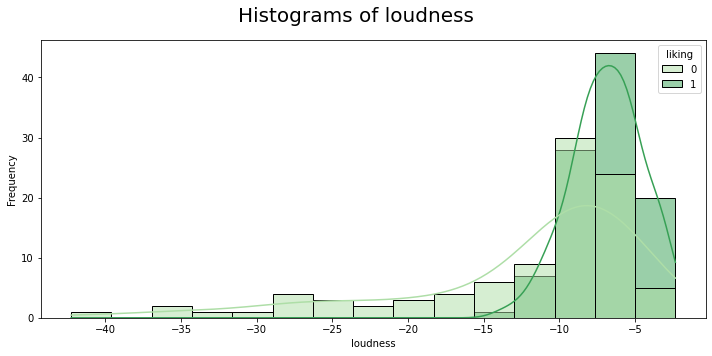

In [70]:
plt.figure(figsize=(10,5))
plt.suptitle('Histograms of loudness', fontsize = 20)
ax1 = sns.histplot(x = data['loudness'],color= 'teal', hue= data['liking'], bins= 15, kde= True, palette= 'Greens')
ax1.set(xlabel= 'loudness', ylabel= 'Frequency')
plt.tight_layout()
plt.show()

## OBSERVATIONS:


    - every liked track ranks at least -15 in loudness
    
    
    - although a track may be loud, it is not necessarily liked
    
    
    - liked and disliked tracks are negatively skewed(skewed left) in loudness

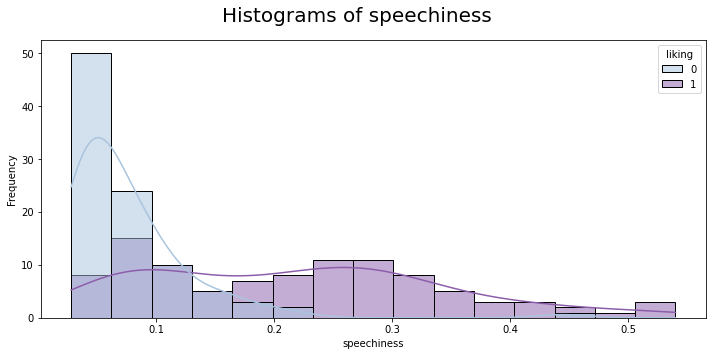

In [71]:
plt.figure(figsize=(10,5))
plt.suptitle('Histograms of speechiness', fontsize = 20)
ax1 = sns.histplot(x = data['speechiness'],color= 'teal', hue= data['liking'], bins= 15, kde= True, palette= 'BuPu')
ax1.set(xlabel= 'speechiness', ylabel= 'Frequency')
plt.tight_layout()
plt.show()

## OBSERVATIONS:


    - liked tracks vary in speechiness, but are generally high in speechiness compared to disliked tracks
    
    
    - disliked tracks are typically low in speechiness
    
    
    - disliked tracks are more positively skewed(skewed right) than liked tracks

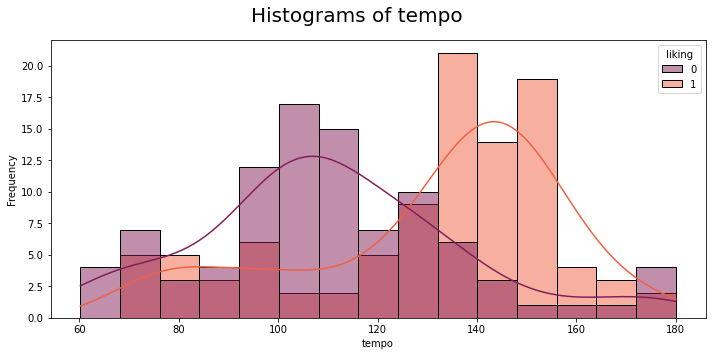

In [111]:
plt.figure(figsize=(10,5))
plt.suptitle('Histograms of tempo', fontsize = 20)
ax1 = sns.histplot(x = data['tempo'],color= 'yellow', hue= data['liking'], bins= 15, kde= True, palette= 'rocket')
ax1.set(xlabel= 'tempo', ylabel= 'Frequency')
plt.tight_layout()
plt.show()

## OBSERVATIONS:


    - liked tracks are generally high in tempo, around 150 bpm


    - disliked tracks are generally lower than liked tracks in tempo around, 110 bpm


    - disliked tracks are slightly positively skewed(skewed right) while liked tracks, are slighly negatively skewed

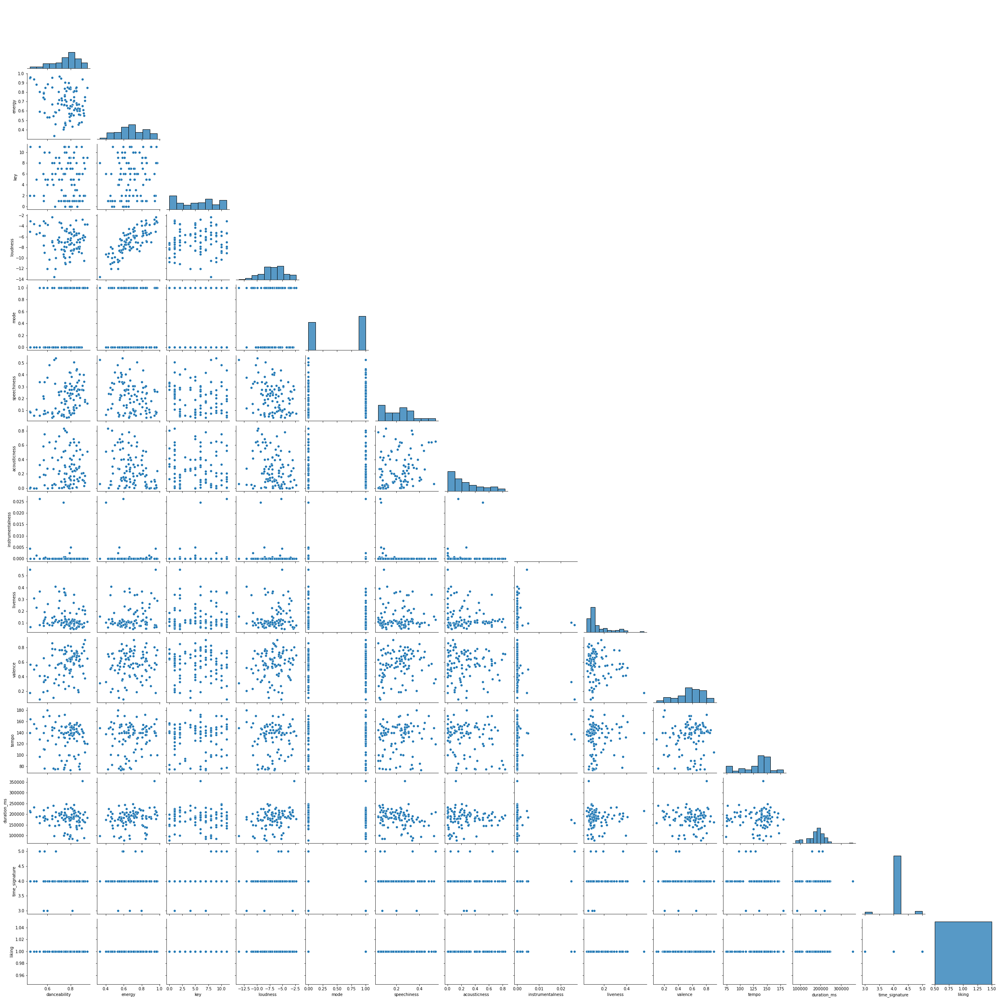

In [72]:
sns.pairplot(good, palette="twilight", corner=True);

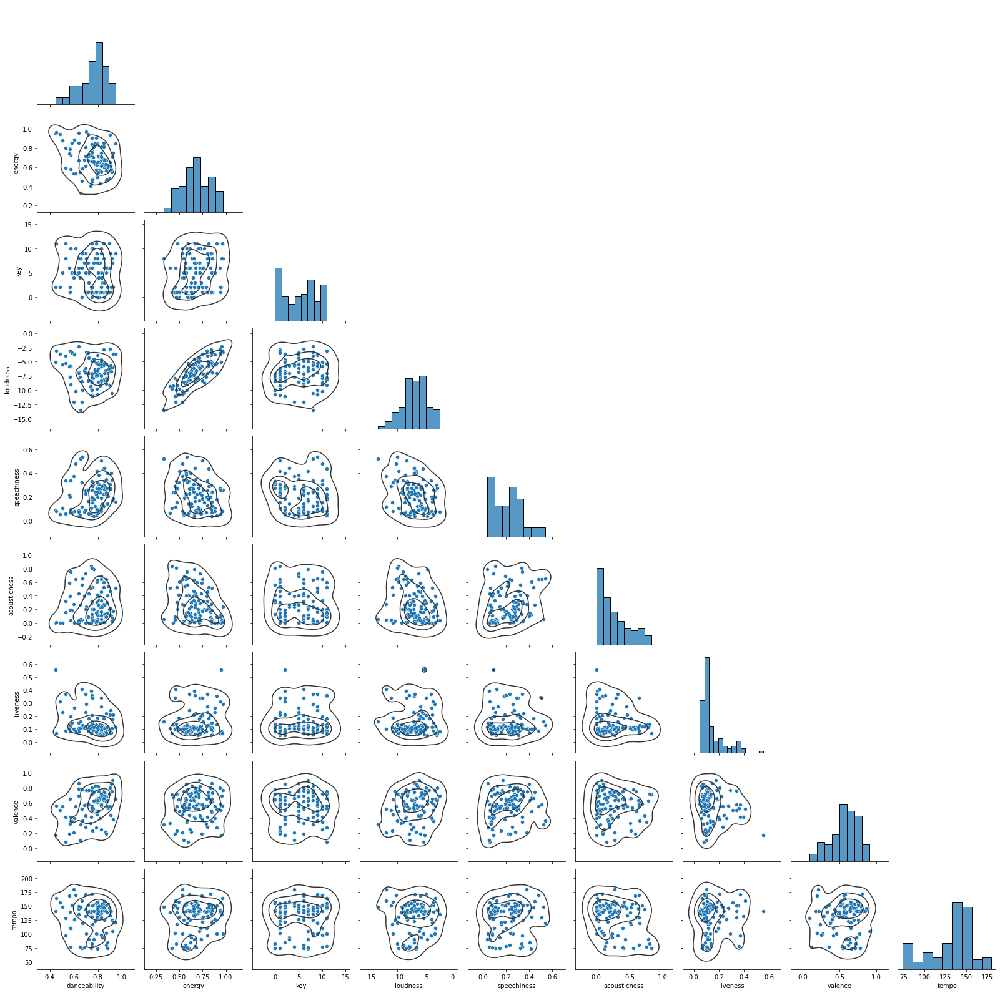

In [76]:
a=sns.pairplot(good[['danceability','energy','key','loudness','speechiness','acousticness','liveness','valence','tempo']], corner=True);
a.map_lower(sns.kdeplot, levels=4, color=".2")

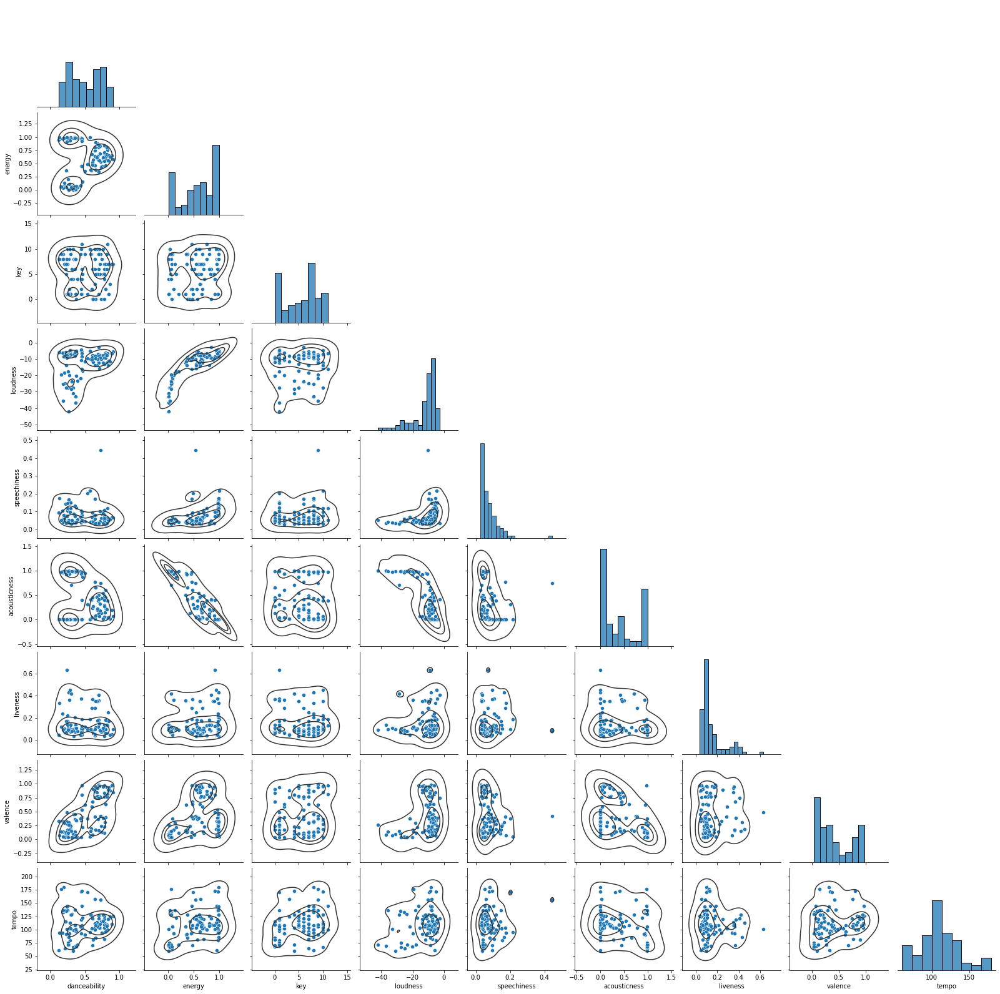

In [77]:
b=sns.pairplot(dislike[['danceability','energy','key','loudness','speechiness','acousticness','liveness','valence','tempo']], corner=True);
b.map_lower(sns.kdeplot, levels=4, color=".2")

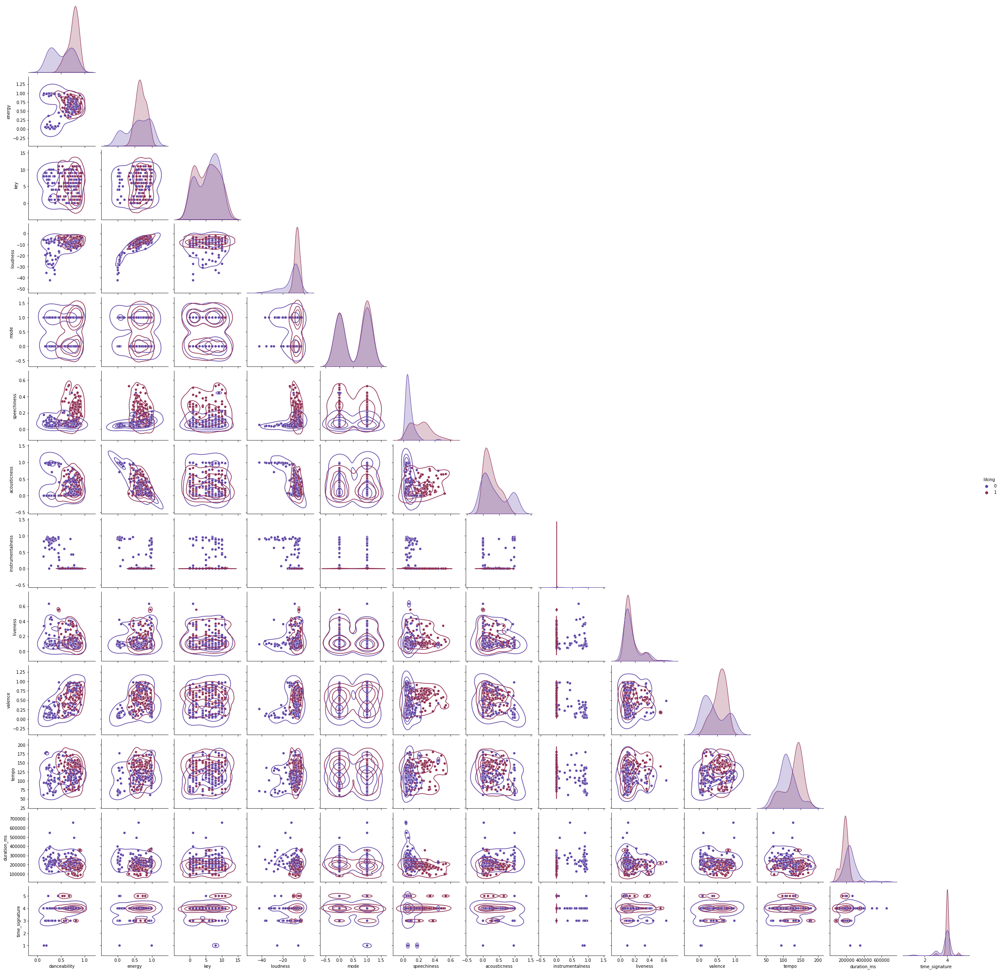

In [81]:
c=sns.pairplot(data,hue="liking", palette="twilight", corner=True);
c.map_lower(sns.kdeplot, levels=4, color=".2")


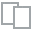
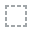
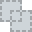
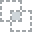
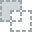
...
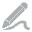
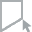
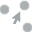
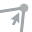
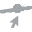

In [86]:
from dataprep.eda import plot_diff
plot_diff([good,dislike], config={"diff.label": ["liked", "disliked"]})